<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Synthetic-Data-Generation-Experiments" data-toc-modified-id="Synthetic-Data-Generation-Experiments-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Synthetic Data Generation Experiments</a></span></li><li><span><a href="#Convenience-Functions" data-toc-modified-id="Convenience-Functions-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Convenience Functions</a></span></li><li><span><a href="#Get-some-data." data-toc-modified-id="Get-some-data.-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Get some data.</a></span></li><li><span><a href="#Extracting-SPY-sector-ETFs" data-toc-modified-id="Extracting-SPY-sector-ETFs-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Extracting SPY sector ETFs</a></span><ul class="toc-item"><li><span><a href="#View-example-plots-with-XLE" data-toc-modified-id="View-example-plots-with-XLE-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>View example plots with <code>XLE</code></a></span></li><li><span><a href="#Select-the-bootstrap-parameters-and-run" data-toc-modified-id="Select-the-bootstrap-parameters-and-run-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Select the bootstrap parameters and run</a></span></li></ul></li><li><span><a href="#Correlation-Investigation" data-toc-modified-id="Correlation-Investigation-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Correlation Investigation</a></span><ul class="toc-item"><li><span><a href="#correlation-between-sectors" data-toc-modified-id="correlation-between-sectors-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>correlation between sectors</a></span></li><li><span><a href="#correlation-between-real-and-synthetic-series" data-toc-modified-id="correlation-between-real-and-synthetic-series-5.2"><span class="toc-item-num">5.2&nbsp;&nbsp;</span>correlation between real and synthetic series</a></span></li></ul></li><li><span><a href="#Generate-synthetics-for-all-sectors" data-toc-modified-id="Generate-synthetics-for-all-sectors-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Generate synthetics for all sectors</a></span></li><li><span><a href="#Examine-correlations-across-synthetic-realizations" data-toc-modified-id="Examine-correlations-across-synthetic-realizations-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Examine correlations across synthetic realizations</a></span></li><li><span><a href="#Regenerate-synthetics-with-larger-blocks" data-toc-modified-id="Regenerate-synthetics-with-larger-blocks-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Regenerate synthetics with larger blocks</a></span></li><li><span><a href="#Regenerate-Synthetics-with-Smaller-Blocks" data-toc-modified-id="Regenerate-Synthetics-with-Smaller-Blocks-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Regenerate Synthetics with Smaller Blocks</a></span></li><li><span><a href="#Additional-ETF-synthetics" data-toc-modified-id="Additional-ETF-synthetics-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Additional ETF synthetics</a></span><ul class="toc-item"><li><span><a href="#Rolling-Volatility" data-toc-modified-id="Rolling-Volatility-10.1"><span class="toc-item-num">10.1&nbsp;&nbsp;</span>Rolling Volatility</a></span></li></ul></li></ul></div>

## Synthetic Data Generation Experiments

In this notebook I experiment with synthetic data generation using block bootstrap methods available from the `arch` package. The basic idea is to compare the aspects of the real series with the bootstrapped versions. 

In [1]:
%load_ext autoreload
%autoreload 2

%load_ext watermark

from pathlib import Path
import time 
from pprint import pprint, pformat

import pandas as pd
import numpy as np
import scipy.stats as stats
import statsmodels.api as sm
import numba as nb
from arch.bootstrap import CircularBlockBootstrap

# import visual tools
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import seaborn as sns

sns_params = {
    'font.size':9.5,
    'font.weight':'medium',
    'figure.figsize':(10,7),
}

plt.style.use('seaborn-talk')
plt.style.use('bmh')
#plt.style.use('dark_background')
sns.set_context(sns_params)
savefig_kwds=dict(dpi=300, bbox_inches='tight', frameon=True, format='png')
nanex_colors = ("#f92b20", "#fe701b", "#facd1f", "#d6fd1c", "#65fe1b",
                "#1bfe42", "#1cfdb4", "#1fb9fa", "#1e71fb", "#261cfd")
nanex_cmap = mpl.colors.ListedColormap(nanex_colors,name='nanex_cmap')
plt.register_cmap('nanex_cmap', cmap=nanex_cmap)
# import util libs
from tqdm import tqdm, tqdm_notebook
import warnings
warnings.filterwarnings("ignore")

from src.tools.pystore_tools import *
from src.tools.utils import *
from src.CONSTANTS import PROJECT_REPO_NAME

pdir = get_relative_project_dir(
    project_repo_name=PROJECT_REPO_NAME, partial=False)
data_dir = Path(pdir/'data')

%watermark -v -m -g
print()
%watermark --iversions

CPython 3.7.2
IPython 6.5.0

compiler   : GCC 7.3.0
system     : Linux
release    : 4.19.11-041911-generic
machine    : x86_64
processor  : x86_64
CPU cores  : 12
interpreter: 64bit
Git hash   : 35d8ca2d13e1b93c7e794bba4ad5deadba2f69fb

pandas      0.23.4
numpy       1.15.4
numba       0.41.0
matplotlib  3.0.2
seaborn     0.9.0
pystore     0.1.5
dask        1.0.0
logzero     1.5.0



## Convenience Functions

Below I have aggregated some convenience functions to plot the various statistics such as mean, std, min, max, and autocorrelation structures between the real series and the synthetic. The plots also feature comparisons of the indexed price series among the various realizations.

In [2]:
def plot_autocorr(s, lags=50, figsize=(10,7), title=None): 
    fig = plt.figure(figsize=figsize)
    layout = 2, 2
    acf_ax = plt.subplot2grid(layout, (0, 0))
    abs_acf_ax = plt.subplot2grid(layout, (0, 1))
    pacf_ax = plt.subplot2grid(layout, (1, 0))
    squared_ax = plt.subplot2grid(layout, (1, 1))
    
    sm.graphics.tsa.plot_acf(s, fft=True, zero=False, lags=lags, ax=acf_ax,
                             title='Autocorrelation of Returns');
    
    sm.graphics.tsa.plot_acf(s.abs(), fft=True, zero=False,
                             lags=lags, ax=abs_acf_ax,
                             title='Autocorrelation of Absolute Returns');
    
    sm.graphics.tsa.plot_pacf(s, zero=False, lags=lags, ax=pacf_ax,
                              title='Partial Autocorrelation of Returns');
    
    sm.graphics.tsa.plot_acf(s**2, fft=True, zero=False,
                             lags=lags, ax=squared_ax,
                             title='Autocorrelation of Squared Returns');
    
    if title: fig.suptitle(title, fontweight='demi', fontsize=16)
    fig.tight_layout()
    fig.subplots_adjust(top=0.88)
    return

def plot_mean_dist(returns, sim_returns, ax):
    
    mean_return = returns.mean()
    
    ax.set_title(f'{returns.name} mean return: {mean_return:.4f}')
    sim_means = sim_returns.mean().squeeze()

    g = sns.distplot(sim_means, kde=False, ax=ax)
    g.axvline(mean_return, color='r')    
    return
    
def plot_std_dist(returns, sim_returns, ax):
    
    std = returns.std()
    
    ax.set_title(f'{returns.name} return std: {std:.4f}')
    sim_stds = sim_returns.std().squeeze()

    g = sns.distplot(sim_stds, kde=False, ax=ax)
    g.axvline(std, color='r')    
    return

def plot_min_dist(returns, sim_returns, ax):
    
    min_ = returns.min()
    
    ax.set_title(f'{returns.name} return min: {min_:.4f}')
    sim_mins = sim_returns.min().squeeze()

    g = sns.distplot(sim_mins, kde=False, ax=ax)
    g.axvline(min_, color='r')    
    return

def plot_max_dist(returns, sim_returns, ax):
    
    max_ = returns.max()
    
    ax.set_title(f'{returns.name} return max: {max_:.4f}')
    sim_maxs = sim_returns.max().squeeze()

    g = sns.distplot(sim_maxs, kde=False, ax=ax)
    g.axvline(max_, color='r')    
    return

def plot_autocorr_dist(returns, sim_returns, ax):
    
    autocorr = returns.autocorr()

    ax.set_title(f'{returns.name} return autocorr: {autocorr:.4f}')
    sim_autocorrs = sim_returns.apply(pd.Series.autocorr).squeeze()

    g = sns.distplot(sim_autocorrs, kde=False, ax=ax)
    g.axvline(autocorr, color='r') 
    return

def plot_stat_dist(returns, sim_returns, figsize=(10,7)):
    fig = plt.figure(figsize=figsize, constrained_layout=True)
    gs = fig.add_gridspec(3, 2)
    plot_mean_dist(returns, sim_returns, fig.add_subplot(gs[0,0]))
    plot_std_dist(returns, sim_returns, fig.add_subplot(gs[0,1]))
    plot_min_dist(returns, sim_returns, fig.add_subplot(gs[1,0])) 
    plot_max_dist(returns, sim_returns, fig.add_subplot(gs[1,1])) 
    plot_autocorr_dist(returns, sim_returns, fig.add_subplot(gs[2,:]))
    
    fig.suptitle(f'{returns.name} simulated stat distributions',
                 fontweight='demi', fontsize=16)
    fig.tight_layout()
    fig.subplots_adjust(top=0.88)
    return



In [3]:
def to_returns(s): return np.log(s/s.shift(1)).dropna()

def to_price_index(df, start=100):
    return (start * (np.exp(df.cumsum())))

def cdescribe(x, n_cols=None):
    if not n_cols:
        d = x.describe()
        d.loc['skew'] = x.skew()
        d.loc['kurtosis'] = x.kurtosis()
        return d
    else:
        x_ = x.sample(n_cols, axis=1)
        d = x_.describe()
        d.loc['skew'] = x_.skew()
        d.loc['kurtosis'] = x_.kurtosis()        
        return d
    
def CBB(s, blocksize, N_paths):
    sim_returns = []

    bs = CircularBlockBootstrap(blocksize, s)
    for i, data in enumerate(tqdm(bs.bootstrap(N_paths))):
        tmp = data[0][0].reset_index(drop=True)
        sim_returns.append(tmp)
    simulations = pd.concat(sim_returns, axis=1, ignore_index=True)
    return simulations      

def compare_stats(x, y, n_cols=None):
    pd.options.display.float_format = '{:,.4f}'.format
    data = (pd.concat([cdescribe(x), cdescribe(y, n_cols=n_cols)], axis=1))
    return data

In [4]:
def view_all(real, sims, n_cols=20, cmap=None):
    plt.set_cmap(cmap)
    display(compare_stats(real, sims, n_cols=20))
    plot_stat_dist(real, sims)
    plot_autocorr(real, title=f'{real.name} Real Returns')
    rand_col = np.random.randint(len(sims.columns), size=1)[0]
    plot_autocorr(sims[rand_col], 
                  title=f'Simulated Return Path {rand_col}')
    return
    
def plot_realizations(real, sims, start, 
                      n_plot_paths=50, figsize=(10,7), cmap=None):   
    plt.set_cmap(cmap)
    sim_prices = to_price_index(sims, start=100)

    fig, ax = plt.subplots(figsize=figsize)
    (sim_prices.sample(n_plot_paths, axis=1)
     .plot(legend=False, alpha=0.7, lw=1., ax=ax))
    (to_price_index(real.reset_index(drop=True))
     .plot(legend=True, ax=ax, lw=5, ls='--', color='k'))
    plt.title(f'{real.name} {n_plot_paths} simulated price paths')

## Get some data.

Below is intraday data from the `iex` trading exchange sampled at a 30 sec resolution, resampled to 1 mean using the mean price over the period. The data covers approximately 3 months ending in December 2018.

In [5]:
infp = Path(data_dir/'processed'/'etf_symbols_01.parq')
all_df = pd.read_parquet(infp).swaplevel().sort_index()
cprint(all_df)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
                            lastSalePrice  lastSaleSize         volume  \
dates               symbol                                               
2018-12-31 13:59:00 XME         26.100000    603.333333   18626.000000   
                    XOP         26.425000     74.000000  394477.333333   
                    XPH         36.490000    200.000000    1328.000000   
                    XRT         40.868333    175.333333  134839.333333   
                    XSD         64.600000    100.000000     200.000000   

                               spread  mid_price  dollar_volume  
dates               symbol                                       
2018-12-31 13:59:00 XME      0.060000  26.130000      486141.60  
                    XOP    -17.610000  17.611667    10424067.99  
                    XPH      0.0000

In [6]:
prices = all_df['lastSalePrice'].unstack()
cprint(prices)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
symbol                    AAXJ       ACWI    ACWV   ACWX         AGG     BIL  \
dates                                                                          
2018-12-31 13:55:00  63.971667  63.971667  81.090  41.86  106.455000  91.455   
2018-12-31 13:56:00  63.990000  63.990000  81.035  41.86  106.455000  91.455   
2018-12-31 13:57:00  63.905000  63.905000  81.035  41.86  106.465000  91.455   
2018-12-31 13:58:00  63.900000  63.900000  81.030  41.86  106.481667  91.455   
2018-12-31 13:59:00  63.936667  63.936667  81.030  41.86  106.498333  91.455   

symbol                  BIV    BKF        BLV        BND  ...         XLK  \
dates                                                     ...               
2018-12-31 13:55:00  81.265  37.45  87.420000  79.180000  ...   61.696667   
2018-12-31 13:56:00  81.26

## Extracting SPY sector ETFs

In [7]:
sector = [x for x in prices.columns if x.startswith('XL')]
sectors = prices[sector].dropna()
cprint(sectors)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
symbol                     XLB        XLE        XLF        XLI        XLK  \
dates                                                                        
2018-12-31 13:55:00  50.290000  57.011667  23.693333  64.116667  61.696667   
2018-12-31 13:56:00  50.278333  57.060000  23.713333  64.128333  61.706667   
2018-12-31 13:57:00  50.195000  56.940000  23.666667  63.996667  61.536667   
2018-12-31 13:58:00  50.190000  56.990000  23.668333  64.003333  61.586667   
2018-12-31 13:59:00  50.250000  57.091667  23.700000  64.076667  61.643333   

symbol                     XLP        XLU        XLV        XLY  
dates                                                            
2018-12-31 13:55:00  50.583333  52.821667  86.020000  98.538333  
2018-12-31 13:56:00  50.623333  52.841667  86.046667  98.610000  
2018-12

compute the returns.

In [8]:
sector_returns = to_returns(sectors).dropna()

### View example plots with `XLE`

In [9]:
xle = sector_returns['XLE']
cprint(xle)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
                          XLE
dates                        
2018-12-31 13:55:00  0.000556
2018-12-31 13:56:00  0.000847
2018-12-31 13:57:00 -0.002105
2018-12-31 13:58:00  0.000878
2018-12-31 13:59:00  0.001782
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 20028 entries, 2018-10-01 07:33:00 to 2018-12-31 13:59:00
Data columns (total 1 columns):
XLE    20028 non-null float64
dtypes: float64(1)
memory usage: 312.9 KB
None
-------------------------------------------------------------------------------



### Select the bootstrap parameters and run

In [10]:
N_paths = 1_000
block_size = 100
xle_sims = CBB(xle, blocksize=block_size, N_paths=N_paths)

1000it [00:00, 2103.48it/s]


,XLE,62,15,82,922,601,290,293,871,457,...,765,65,843,474,877,42,728,458,574,685
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0009,0.0010,0.0010,0.0010,0.0009,0.0009,0.0009,0.0009,0.0009,0.0009,...,0.0010,0.0010,0.0010,0.0010,0.0008,0.0011,0.0010,0.0009,0.0009,0.0009
min,-0.0285,-0.0285,-0.0285,-0.0285,-0.0285,-0.0190,-0.0285,-0.0285,-0.0243,-0.0285,...,-0.0285,-0.0285,-0.0237,-0.0285,-0.0148,-0.0285,-0.0285,-0.0243,-0.0285,-0.0285
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0004,-0.0004,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0276,0.0276,0.0238,0.0276,0.0276,0.0276,0.0238,0.0276,0.0276,0.0276,...,0.0276,0.0276,0.0238,0.0276,0.0158,0.0276,0.0238,0.0276,0.0276,0.0276
skew,-1.1478,-1.7493,-4.3336,-1.7894,-0.4918,4.8033,-3.7040,-3.3357,-2.9062,-1.3815,...,-1.6492,-1.8320,0.9217,-0.8227,0.0548,-1.7132,-0.3340,-0.8187,-6.3225,0.7036
kurtosis,214.0395,232.1456,205.1655,198.4600,196.8028,209.8321,224.1785,249.4489,224.3600,225.7883,...,206.3803,244.7167,168.1456,226.0526,70.0080,256.0923,211.2428,189.3176,279.1243,196.5652


<Figure size 432x288 with 0 Axes>

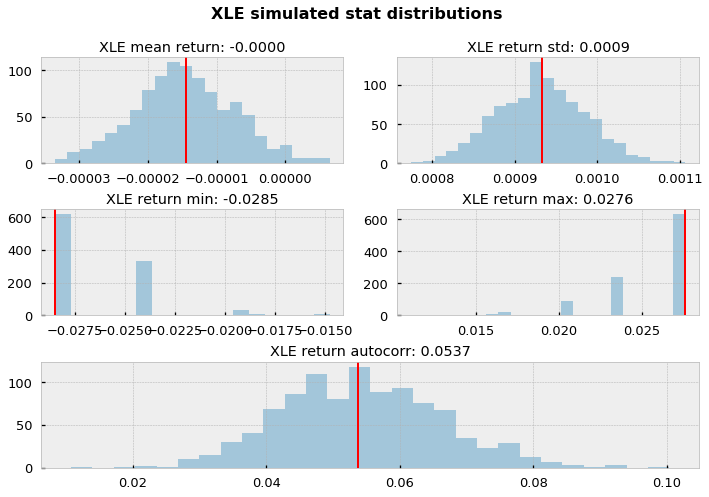

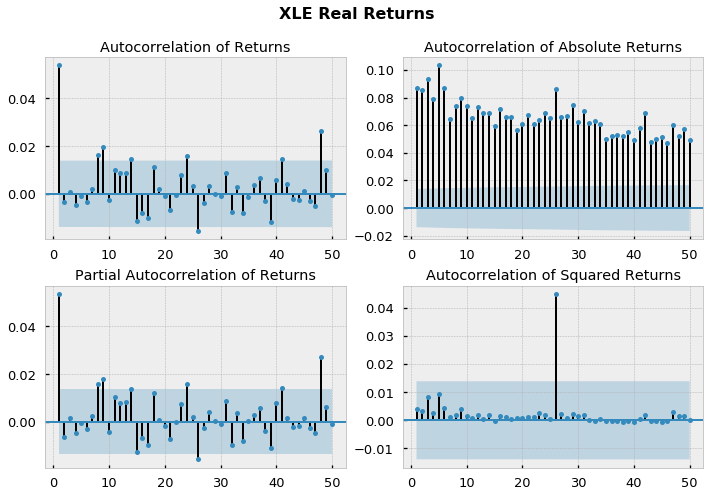

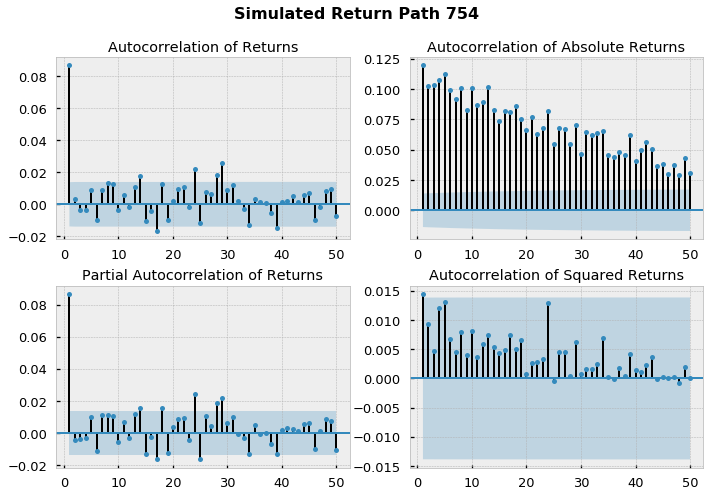

In [11]:
view_all(xle, xle_sims, cmap=None)

<Figure size 432x288 with 0 Axes>

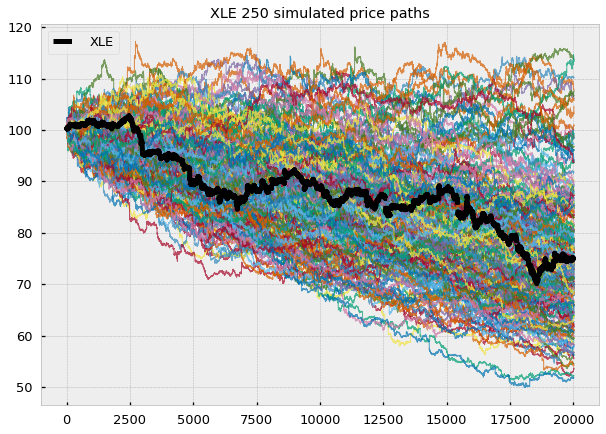

In [12]:
plot_realizations(xle, xle_sims, start=100, 
                  n_plot_paths=250, cmap='nanex_cmap')

## Correlation Investigation

### correlation between sectors

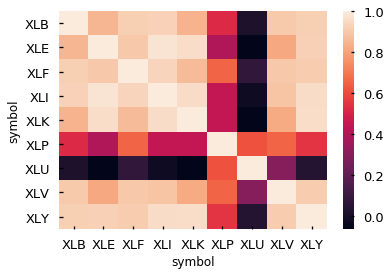

In [13]:
sns.heatmap(sectors.corr())

### correlation between real and synthetic series

In [14]:
concat = pd.concat([xle.reset_index(drop=True), xle_sims],axis=1)
concat.corrwith(concat['XLE'])

XLE    1.0000
0      0.0022
1     -0.0054
2      0.0080
3      0.0076
4      0.0053
5     -0.0108
6      0.0045
7     -0.0012
8      0.0106
9      0.0029
10    -0.0096
11     0.0003
12     0.0013
13    -0.0065
14    -0.0029
15     0.0016
16    -0.0020
17     0.0063
18    -0.0030
19     0.0059
20    -0.0052
21     0.0069
22     0.0023
23     0.0036
24     0.0000
25     0.0007
26    -0.0051
27     0.0154
28     0.0021
        ...  
970    0.0060
971   -0.0007
972    0.0004
973    0.0018
974    0.0017
975   -0.0063
976    0.0079
977   -0.0030
978   -0.0030
979   -0.0068
980    0.0001
981   -0.0023
982    0.0030
983   -0.0080
984   -0.0047
985   -0.0062
986    0.0047
987    0.0062
988   -0.0192
989    0.0028
990   -0.0018
991    0.0012
992   -0.0042
993    0.0084
994    0.0033
995    0.0108
996   -0.0051
997    0.0007
998   -0.0164
999   -0.0068
Length: 1001, dtype: float64

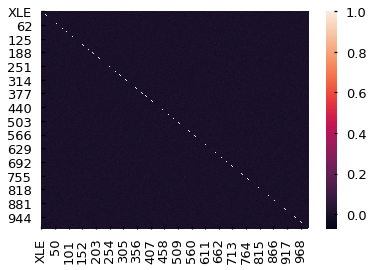

In [15]:
sns.heatmap(concat.corr())

## Generate synthetics for all sectors

2000it [00:01, 1898.11it/s]


,XLB,1246,514,824,172,592,1876,62,1277,912,...,1368,394,1766,720,821,613,360,871,1718,498
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0007,0.0008,0.0007,0.0008,0.0008,0.0007,0.0008,0.0008,...,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0007,0.0008,0.0008,0.0008
min,-0.0212,-0.0212,-0.0212,-0.0165,-0.0212,-0.0210,-0.0210,-0.0165,-0.0212,-0.0212,...,-0.0212,-0.0212,-0.0210,-0.0212,-0.0212,-0.0165,-0.0212,-0.0212,-0.0212,-0.0210
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0002,0.0002,...,0.0002,0.0002,0.0001,0.0002,0.0002,0.0001,0.0002,0.0001,0.0002,0.0001
max,0.0215,0.0209,0.0185,0.0215,0.0185,0.0209,0.0215,0.0215,0.0209,0.0215,...,0.0185,0.0159,0.0215,0.0215,0.0185,0.0215,0.0159,0.0209,0.0215,0.0215
skew,0.1371,3.4367,-3.6326,2.4115,-2.2794,2.1112,3.2886,3.3865,-3.1153,0.0855,...,-1.8573,-0.5275,-1.6819,1.9826,-2.1505,2.4286,-2.2752,-2.1781,-0.4862,-0.0017
kurtosis,181.2890,183.9256,167.0301,169.2249,163.8458,202.9235,177.4138,204.5612,186.1422,201.5498,...,168.2814,115.5665,151.4552,178.6772,175.8756,204.7690,114.3395,188.8145,155.7606,165.3744


2000it [00:00, 2220.22it/s]


,XLE,759,103,71,598,221,1232,951,1581,1653,...,113,1800,293,1002,260,1419,1109,233,305,1076
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000
std,0.0009,0.0009,0.0009,0.0009,0.0010,0.0009,0.0010,0.0010,0.0009,0.0009,...,0.0010,0.0009,0.0009,0.0010,0.0010,0.0009,0.0009,0.0009,0.0009,0.0009
min,-0.0285,-0.0243,-0.0285,-0.0243,-0.0243,-0.0243,-0.0285,-0.0285,-0.0285,-0.0285,...,-0.0285,-0.0285,-0.0285,-0.0285,-0.0285,-0.0190,-0.0237,-0.0285,-0.0285,-0.0243
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0004,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0004,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0276,0.0238,0.0206,0.0238,0.0276,0.0276,0.0238,0.0276,0.0238,0.0276,...,0.0238,0.0206,0.0276,0.0276,0.0276,0.0238,0.0276,0.0276,0.0276,0.0276
skew,-1.1478,-1.4830,-6.2481,-1.3173,-3.2397,0.3533,-3.6229,-2.4384,-1.2847,1.1128,...,-2.8863,-2.3939,0.9301,-0.5514,-0.6464,0.8583,1.5557,-1.4676,-0.4689,-1.7101
kurtosis,214.0395,182.4835,199.5656,178.6037,183.4771,197.4433,233.9060,241.9974,223.3564,214.7726,...,236.0567,144.9644,253.6961,233.6655,229.3406,131.0603,188.0275,246.3730,193.9853,232.7259


2000it [00:00, 2230.02it/s]


,XLF,165,1801,942,857,66,95,1750,1791,1068,...,1337,1076,1295,1477,621,759,545,1856,1443,1012
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0008,0.0009,0.0007,0.0008,0.0009,0.0008,0.0008,0.0008,...,0.0008,0.0009,0.0008,0.0008,0.0009,0.0007,0.0008,0.0008,0.0009,0.0008
min,-0.0240,-0.0240,-0.0240,-0.0240,-0.0157,-0.0199,-0.0240,-0.0240,-0.0199,-0.0240,...,-0.0240,-0.0240,-0.0240,-0.0240,-0.0240,-0.0199,-0.0240,-0.0240,-0.0240,-0.0199
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0196,0.0196,0.0196,0.0143,0.0196,0.0164,0.0196,0.0164,0.0196,0.0164,...,0.0157,0.0196,0.0164,0.0196,0.0196,0.0164,0.0196,0.0164,0.0196,0.0164
skew,-1.8309,-1.7554,-1.2435,-5.9189,1.6907,-1.5710,-2.1141,-5.0086,-2.2237,-2.2848,...,-1.3765,-1.3300,-1.3227,-4.9571,-4.6734,0.5736,-3.9689,-5.0355,-2.6802,-4.1898
kurtosis,163.3457,162.5939,155.3228,213.7059,107.4517,148.1915,151.4556,214.4406,128.9714,177.0564,...,135.6505,166.5284,152.8402,204.5689,158.8608,143.0921,167.7563,233.8225,152.2562,142.7599


2000it [00:00, 2003.05it/s]


,XLI,1270,1052,1346,236,1144,786,387,506,664,...,219,184,892,1127,1400,478,1888,1922,887,1237
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0009,0.0009,0.0008,0.0008,0.0007,0.0008,0.0008,0.0008,...,0.0007,0.0008,0.0008,0.0009,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008
min,-0.0243,-0.0243,-0.0243,-0.0243,-0.0180,-0.0243,-0.0180,-0.0196,-0.0243,-0.0196,...,-0.0196,-0.0196,-0.0243,-0.0243,-0.0243,-0.0243,-0.0196,-0.0243,-0.0243,-0.0196
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0002,-0.0002,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0003,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0223,0.0155,0.0223,0.0223,0.0223,0.0223,0.0223,0.0155,0.0223,0.0155,...,0.0223,0.0223,0.0223,0.0223,0.0223,0.0155,0.0139,0.0223,0.0223,0.0223
skew,-2.0874,-0.3855,-3.9744,-3.4284,-0.8261,1.4367,-1.2278,-3.2678,-2.5994,-0.7865,...,0.7236,0.1356,-4.8223,-4.7804,-3.5214,-3.7292,-3.7543,-2.6257,-2.0061,-1.4708
kurtosis,159.4556,122.5277,150.5805,183.2744,111.6865,210.6491,131.3226,119.1644,216.9766,112.6524,...,150.5052,182.5728,168.0503,204.0371,198.9529,145.5943,119.1048,275.3121,146.9757,156.0997


2000it [00:00, 2064.52it/s]


,XLK,291,516,1721,241,483,760,1744,1799,847,...,59,1293,626,1828,768,247,316,1425,807,1485
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,0.0000
std,0.0010,0.0010,0.0010,0.0009,0.0010,0.0009,0.0010,0.0010,0.0009,0.0010,...,0.0009,0.0009,0.0009,0.0010,0.0009,0.0009,0.0009,0.0011,0.0010,0.0009
min,-0.0250,-0.0217,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0217,-0.0250,...,-0.0203,-0.0250,-0.0250,-0.0250,-0.0250,-0.0217,-0.0250,-0.0217,-0.0250,-0.0217
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0262,0.0262,0.0262,0.0168,0.0262,0.0262,0.0262,0.0262,0.0168,0.0234,...,0.0262,0.0168,0.0262,0.0262,0.0262,0.0262,0.0262,0.0262,0.0262,0.0234
skew,-1.4734,-1.9988,-0.7956,-4.0344,-2.8603,-0.5874,-0.4804,-3.8362,-5.1977,-5.1359,...,3.3713,-2.2663,-2.6618,-0.7318,-3.6745,-2.6720,0.2229,0.5433,-0.5830,-1.6581
kurtosis,169.0033,183.8149,181.2500,180.9159,189.4075,210.7883,181.5797,174.5759,142.3784,169.0867,...,168.3775,154.9194,160.4967,175.1471,177.1576,147.6783,204.2995,172.0769,181.2915,140.2097


2000it [00:01, 1872.83it/s]


,XLP,1963,1825,642,793,311,1973,1380,515,1088,...,1624,653,1655,844,197,1421,343,1178,805,104
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0006,0.0005,0.0006,0.0006,0.0005,0.0006,0.0006,0.0005,0.0006,0.0006,...,0.0006,0.0006,0.0005,0.0006,0.0005,0.0006,0.0006,0.0005,0.0006,0.0006
min,-0.0205,-0.0123,-0.0205,-0.0205,-0.0205,-0.0205,-0.0205,-0.0085,-0.0120,-0.0205,...,-0.0205,-0.0120,-0.0123,-0.0205,-0.0123,-0.0123,-0.0123,-0.0123,-0.0123,-0.0205
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0164,0.0164,0.0100,0.0100,0.0164,0.0164,0.0164,0.0164,0.0164,0.0164,...,0.0164,0.0164,0.0085,0.0164,0.0164,0.0164,0.0164,0.0164,0.0164,0.0164
skew,-2.6199,0.4735,-6.3335,-5.6294,-4.4051,-1.2431,-3.5686,1.4006,-0.8851,-3.8031,...,-5.7357,0.1819,-1.3182,-3.2559,-0.1692,1.0903,0.1457,0.8835,3.6471,-5.2236
kurtosis,179.0759,93.7858,219.0657,197.3337,278.7614,167.7890,276.9132,93.8713,124.8939,263.0938,...,279.6832,96.0415,58.8187,240.3877,99.3617,94.3866,106.0708,143.9933,170.4192,248.1321


2000it [00:00, 2133.72it/s]


,XLU,1763,1546,295,1045,647,1626,1496,1056,1417,...,561,526,1092,789,1805,282,800,1981,1512,946
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,0.0000,0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,...,0.0000,0.0000,-0.0000,0.0000,0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000
std,0.0006,0.0007,0.0006,0.0007,0.0007,0.0007,0.0006,0.0006,0.0006,0.0006,...,0.0006,0.0006,0.0007,0.0006,0.0006,0.0007,0.0006,0.0007,0.0006,0.0006
min,-0.0288,-0.0288,-0.0288,-0.0288,-0.0288,-0.0288,-0.0122,-0.0117,-0.0288,-0.0288,...,-0.0288,-0.0131,-0.0288,-0.0288,-0.0288,-0.0288,-0.0131,-0.0131,-0.0288,-0.0288
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0165,0.0165,0.0165,0.0127,0.0165,0.0127,0.0127,0.0127,0.0165,0.0165,...,0.0165,0.0127,0.0083,0.0127,0.0127,0.0094,0.0165,0.0165,0.0083,0.0165
skew,-4.6218,-5.1809,-4.9789,-4.4373,-10.7475,-10.0379,-0.6546,2.3524,-6.1388,-3.4668,...,-3.8949,-1.7346,-10.2977,-4.7932,-5.0850,-10.0283,0.4614,2.2001,-6.9951,-3.0642
kurtosis,288.4771,296.8368,342.5700,225.4223,524.2665,432.8416,77.9959,83.0560,346.8904,258.8393,...,323.0389,77.5143,426.1454,285.1608,255.2015,389.2546,122.4439,144.1018,283.0038,282.4019


2000it [00:01, 1847.68it/s]


,XLV,1126,934,1935,1388,630,878,1889,1743,418,...,1373,644,1048,461,280,873,600,1769,1010,1788
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000
std,0.0007,0.0006,0.0007,0.0007,0.0007,0.0007,0.0007,0.0006,0.0007,0.0007,...,0.0006,0.0006,0.0007,0.0007,0.0006,0.0007,0.0007,0.0007,0.0006,0.0006
min,-0.0210,-0.0205,-0.0210,-0.0210,-0.0210,-0.0210,-0.0210,-0.0210,-0.0205,-0.0210,...,-0.0210,-0.0210,-0.0205,-0.0205,-0.0210,-0.0210,-0.0210,-0.0210,-0.0152,-0.0117
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0001
max,0.0157,0.0157,0.0157,0.0157,0.0157,0.0156,0.0157,0.0157,0.0157,0.0156,...,0.0065,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,0.0156,0.0156
skew,-2.3524,-5.3992,-0.9982,-1.7147,-1.4485,-7.4021,-2.2142,-2.0682,-0.5933,-4.1903,...,-4.4853,-3.8595,1.8440,-3.0257,-1.9949,-0.6967,-4.4813,-2.2599,-1.6680,2.0904
kurtosis,169.5654,206.9599,136.5111,139.8345,178.7073,247.7387,153.3463,197.5877,127.7627,206.5862,...,110.4798,202.4384,140.8837,154.5529,137.1743,149.0507,281.4487,168.9785,98.2079,102.2093


2000it [00:00, 2012.90it/s]


,XLY,1288,1850,145,1838,1181,1259,785,483,1038,...,1239,202,1943,1732,134,1240,1156,1965,1922,1453
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0009,0.0008,0.0009,0.0009,0.0009,0.0009,0.0009,0.0009,0.0008,0.0009,...,0.0009,0.0009,0.0009,0.0009,0.0008,0.0008,0.0010,0.0009,0.0008,0.0009
min,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0306,...,-0.0306,-0.0347,-0.0306,-0.0347,-0.0239,-0.0347,-0.0347,-0.0306,-0.0237,-0.0306
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0001,-0.0001
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0002,0.0002,0.0001,0.0001,0.0001
max,0.0243,0.0170,0.0243,0.0243,0.0243,0.0243,0.0243,0.0170,0.0155,0.0155,...,0.0243,0.0243,0.0243,0.0170,0.0170,0.0170,0.0243,0.0243,0.0243,0.0243
skew,-5.8846,-3.4847,-3.4056,-7.5792,-3.4436,-5.0518,-7.5989,-6.8850,-5.2745,-9.2706,...,-3.3213,-1.5341,-1.7072,-7.2687,-6.0347,-9.1775,-7.8613,-3.1853,-0.5883,-2.5349
kurtosis,322.3403,226.9012,372.6300,292.7334,243.5613,311.0593,370.8100,290.6795,274.5929,325.9188,...,276.9286,278.4367,281.7630,372.0641,198.2677,433.4681,363.6691,318.9820,179.0157,274.1203


<Figure size 432x288 with 0 Axes>

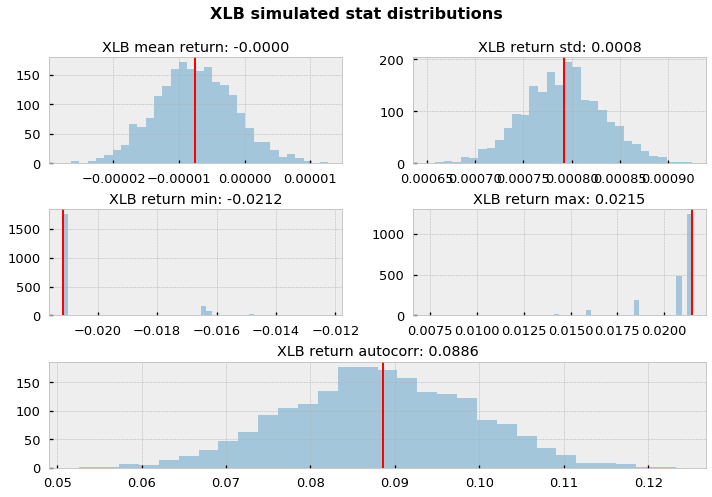

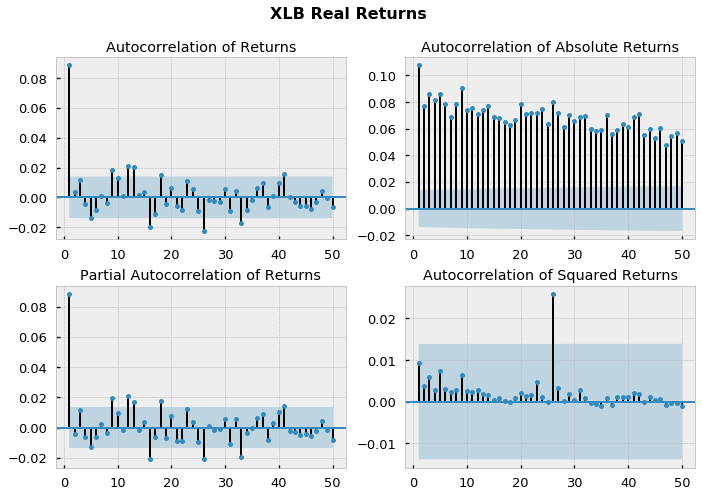

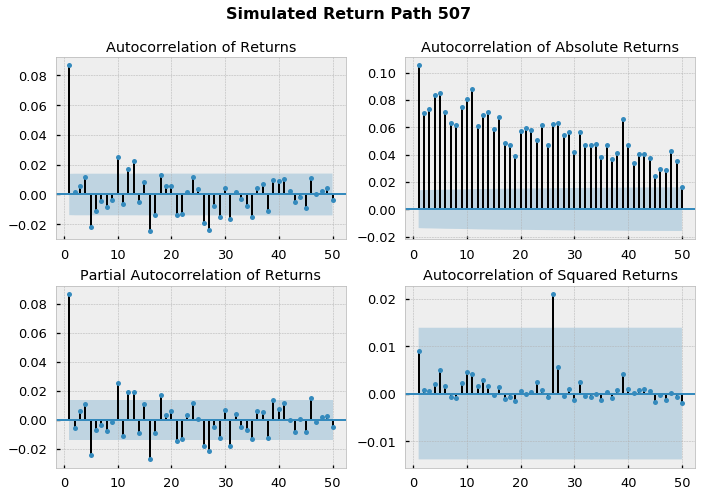

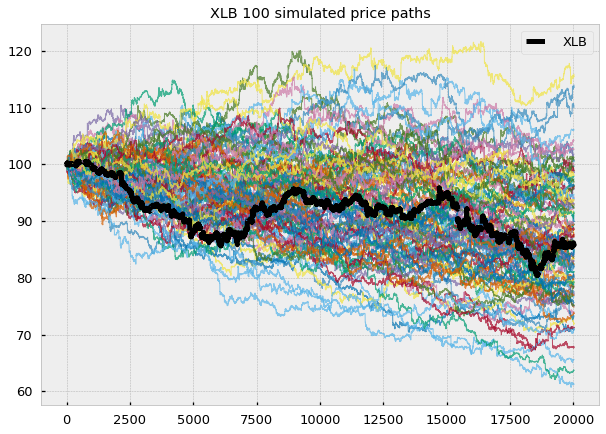

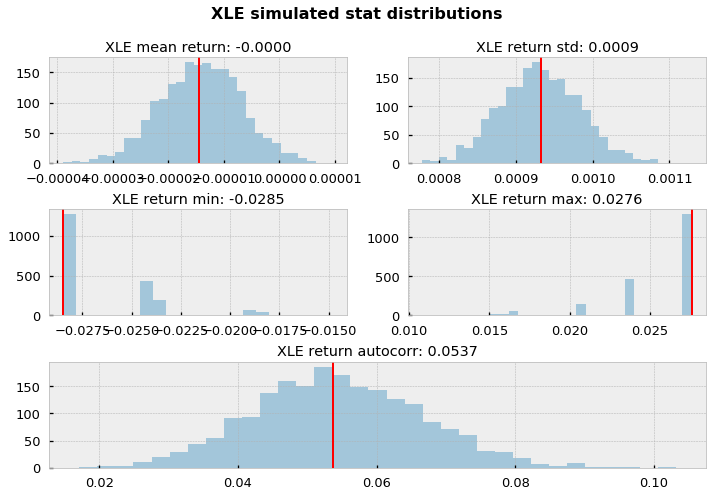

...

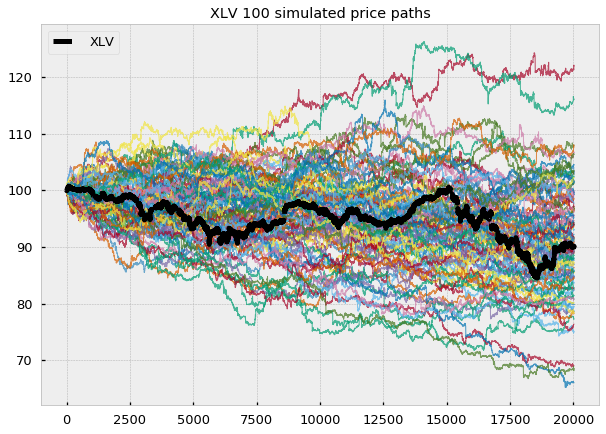

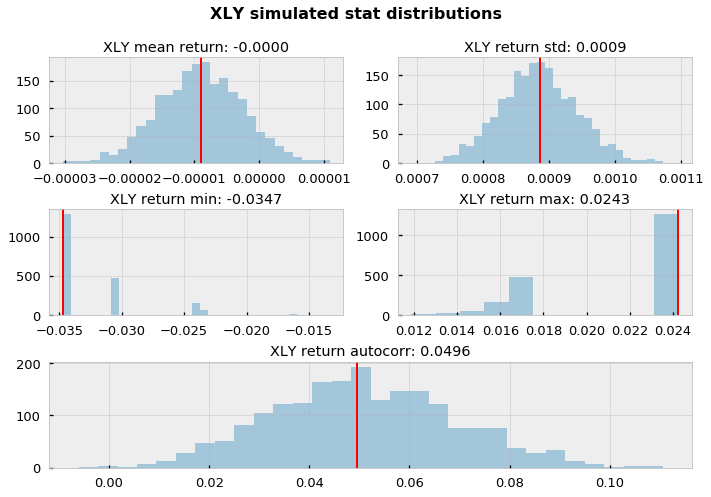

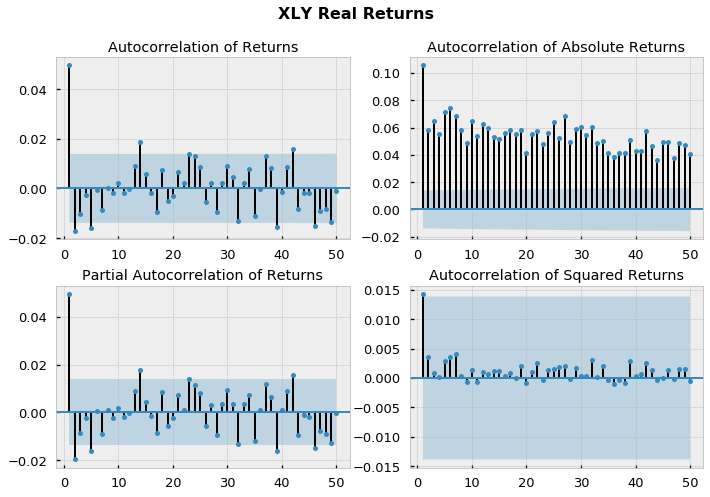

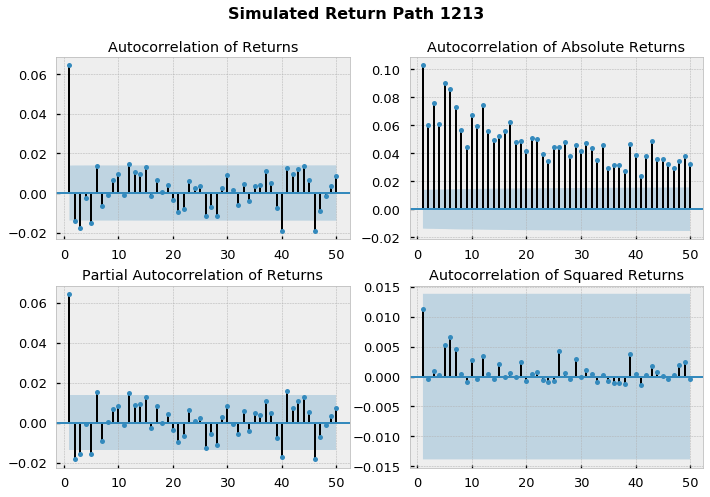

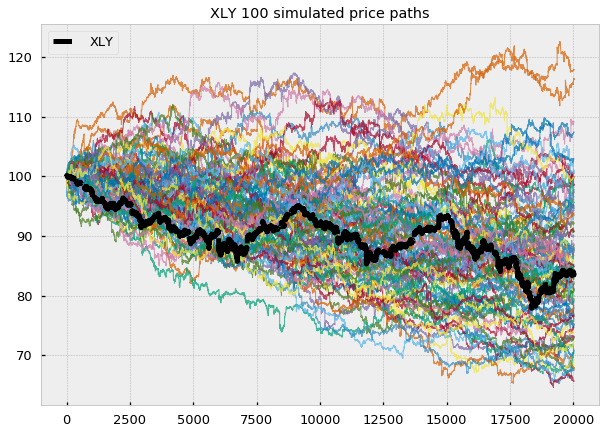

In [16]:
sim_dict = dict()

for sec in sector_returns:
    tmp = sector_returns[sec]
    N_paths = 2000
    block_size = 100
    sec_sims = CBB(tmp, blocksize=block_size, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

## Examine correlations across synthetic realizations

In this section I try to select a random sampling of synthetic realizations and blend them together. Once blended I examine the correlation between the different synthetics that were generated using each of the real sector returns.

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
          XLB     XLE     XLF     XLI    XLK     XLP     XLU     XLV     XLY
20023 -0.0001 -0.0000  0.0000 -0.0003 0.0003 -0.0001  0.0001 -0.0003  0.0002
20024  0.0003  0.0002 -0.0000 -0.0002 0.0001 -0.0001  0.0000  0.0000 -0.0003
20025  0.0001  0.0000  0.0001  0.0004 0.0001 -0.0002 -0.0002 -0.0000 -0.0002
20026 -0.0000 -0.0002  0.0001  0.0006 0.0001 -0.0001  0.0000 -0.0000 -0.0001
20027  0.0000 -0.0000  0.0000  0.0005 0.0002 -0.0001  0.0000  0.0003 -0.0000
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20028 entries, 0 to 20027
Data columns (total 9 columns):
XLB    20028 non-null float64
XLE    20028 non-null float64
XLF    20028 non-null float64
XLI    20028 non-null float64
XLK    20028 non-null float64
XLP    20028 non-null float64
XLU    20028 non-

,XLB,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY
XLB,1.0000,-0.0065,-0.0080,-0.0059,0.0003,0.0042,-0.0112,0.0002,-0.0054
XLE,-0.0065,1.0000,-0.0031,-0.0032,-0.0008,0.0033,0.0066,0.0017,0.0000
XLF,-0.0080,-0.0031,1.0000,0.0076,-0.0104,0.0040,0.0006,0.0006,-0.0121
XLI,-0.0059,-0.0032,0.0076,1.0000,0.0028,-0.0039,0.0052,0.0075,-0.0038
XLK,0.0003,-0.0008,-0.0104,0.0028,1.0000,-0.0021,0.0046,-0.0103,-0.0158
XLP,0.0042,0.0033,0.0040,-0.0039,-0.0021,1.0000,-0.0024,0.0067,-0.0005
XLU,-0.0112,0.0066,0.0006,0.0052,0.0046,-0.0024,1.0000,0.0042,0.0157
XLV,0.0002,0.0017,0.0006,0.0075,-0.0103,0.0067,0.0042,1.0000,-0.0023
XLY,-0.0054,0.0000,-0.0121,-0.0038,-0.0158,-0.0005,0.0157,-0.0023,1.0000


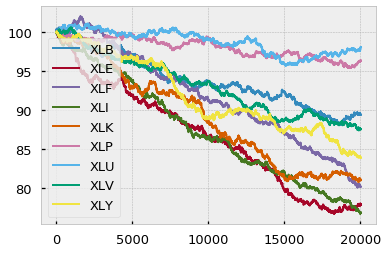

In [17]:
n_cols = 10
merged = dict()

for sym in sim_dict.keys():
    np.random.seed(0)
    tmp = sim_dict[sym]
    # pick random set of columns
    col_idx = np.random.randint(0, len(tmp.columns)+1, n_cols)
    merged[sym] = tmp[col_idx].mean(axis=1)

df = pd.DataFrame(merged)
cprint(df)

display(df.corr())

to_price_index(df).plot()

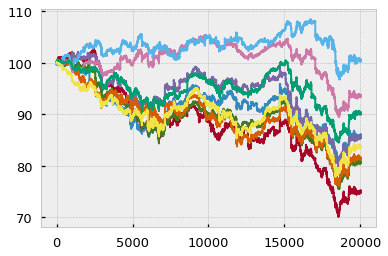

In [18]:
to_price_index(sector_returns.reset_index(drop=True)).plot(legend=False)

## Regenerate synthetics with larger blocks

In [19]:
bsize = len(sector_returns)//10
bsize

2002

2000it [00:01, 1964.18it/s]


,XLB,1896,175,1678,1556,1775,980,597,1170,1831,...,966,828,215,1559,522,884,156,229,1439,943
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0009,0.0008,0.0007,0.0008,0.0007,0.0007,0.0007,0.0008,0.0008,...,0.0008,0.0009,0.0007,0.0008,0.0008,0.0008,0.0008,0.0008,0.0007,0.0007
min,-0.0212,-0.0212,-0.0212,-0.0165,-0.0212,-0.0210,-0.0212,-0.0165,-0.0212,-0.0212,...,-0.0210,-0.0212,-0.0212,-0.0210,-0.0212,-0.0212,-0.0212,-0.0212,-0.0210,-0.0210
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0001,-0.0001,-0.0001,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0001
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0002,0.0001,0.0001,0.0001,0.0002,0.0002,0.0002,0.0001,0.0002,0.0001
max,0.0215,0.0215,0.0215,0.0215,0.0215,0.0185,0.0215,0.0215,0.0215,0.0215,...,0.0209,0.0215,0.0215,0.0209,0.0215,0.0209,0.0215,0.0209,0.0159,0.0136
skew,0.1371,0.5961,2.9020,2.6371,0.4968,-0.4889,-3.7657,-0.0501,-2.6834,-0.9591,...,0.6904,-0.2199,-0.0850,-2.9673,1.5027,1.8141,2.7429,-1.2280,-2.3784,-3.6000
kurtosis,181.2890,203.6852,198.2933,153.7250,227.2436,202.1635,246.6032,189.2459,217.0933,214.7765,...,125.3999,222.3020,195.4388,171.6026,178.4131,137.2013,171.5601,156.1754,106.8695,142.9359


2000it [00:00, 2064.86it/s]


,XLE,1531,1619,1358,839,1068,361,1906,1850,311,...,931,671,29,863,557,1462,1143,234,55,819
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0009,0.0009,0.0010,0.0009,0.0008,0.0009,0.0010,0.0008,0.0009,0.0010,...,0.0008,0.0009,0.0009,0.0009,0.0009,0.0009,0.0009,0.0009,0.0008,0.0009
min,-0.0285,-0.0285,-0.0285,-0.0285,-0.0190,-0.0285,-0.0243,-0.0156,-0.0243,-0.0285,...,-0.0285,-0.0243,-0.0243,-0.0285,-0.0237,-0.0237,-0.0285,-0.0285,-0.0243,-0.0237
25%,-0.0003,-0.0003,-0.0004,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0002,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0276,0.0276,0.0238,0.0276,0.0276,0.0238,0.0276,0.0276,0.0276,0.0276,...,0.0276,0.0276,0.0238,0.0238,0.0276,0.0276,0.0276,0.0276,0.0276,0.0276
skew,-1.1478,-2.8715,-2.4582,0.3946,2.0974,-4.9892,3.2422,7.5789,1.1556,-2.7595,...,-2.5221,2.5067,-0.8486,-4.2510,4.5926,3.3340,-0.4775,-1.3597,0.3310,-0.0118
kurtosis,214.0395,261.4171,173.1707,209.9200,157.0713,265.4786,223.0889,305.8699,209.3088,259.2767,...,262.7322,231.0933,176.7496,273.7074,238.4274,240.0153,248.5392,244.1089,251.4077,166.1346


2000it [00:01, 1520.33it/s]


,XLF,1741,3,556,14,1745,1109,1036,1739,1831,...,1273,1254,1907,1349,551,880,966,247,826,1938
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0007,0.0008,0.0007,0.0008,0.0008,0.0008,0.0009,0.0008,...,0.0007,0.0008,0.0009,0.0007,0.0007,0.0007,0.0009,0.0008,0.0009,0.0007
min,-0.0240,-0.0240,-0.0240,-0.0199,-0.0188,-0.0188,-0.0188,-0.0188,-0.0240,-0.0240,...,-0.0240,-0.0199,-0.0240,-0.0240,-0.0199,-0.0199,-0.0240,-0.0240,-0.0240,-0.0199
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0004,-0.0002,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0004,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0196,0.0196,0.0164,0.0196,0.0164,0.0157,0.0157,0.0196,0.0157,0.0196,...,0.0143,0.0157,0.0196,0.0121,0.0196,0.0157,0.0196,0.0157,0.0164,0.0196
skew,-1.8309,-1.9804,-4.5554,-1.5897,-0.6747,0.6518,-1.0601,1.7356,-5.3833,-1.4178,...,-6.6019,-3.0892,-0.8595,-2.7092,-0.9136,-2.2852,0.0343,-4.5681,-5.4322,-1.2552
kurtosis,163.3457,232.6213,215.8258,160.9978,131.2443,117.4986,100.3135,167.8789,191.4928,158.0004,...,242.8285,131.2206,95.7254,153.1437,179.2485,155.6258,142.6622,187.9911,208.2921,179.4559


2000it [00:00, 2101.28it/s]


,XLI,591,756,1122,925,1600,880,166,946,1895,...,913,1003,1283,855,521,432,816,301,1198,1673
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000
std,0.0008,0.0009,0.0009,0.0006,0.0007,0.0007,0.0008,0.0009,0.0008,0.0007,...,0.0008,0.0009,0.0008,0.0009,0.0008,0.0009,0.0008,0.0007,0.0008,0.0008
min,-0.0243,-0.0243,-0.0243,-0.0243,-0.0130,-0.0243,-0.0243,-0.0196,-0.0243,-0.0243,...,-0.0196,-0.0196,-0.0243,-0.0243,-0.0196,-0.0196,-0.0164,-0.0243,-0.0243,-0.0196
25%,-0.0003,-0.0003,-0.0003,-0.0002,-0.0002,-0.0002,-0.0003,-0.0003,-0.0003,-0.0002,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0002,-0.0003,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0003,0.0003,0.0002,0.0002,0.0002,0.0003,0.0003,0.0002,0.0002,...,0.0002,0.0003,0.0003,0.0003,0.0002,0.0003,0.0002,0.0002,0.0002,0.0002
max,0.0223,0.0223,0.0223,0.0223,0.0125,0.0223,0.0223,0.0223,0.0223,0.0223,...,0.0223,0.0223,0.0223,0.0155,0.0223,0.0155,0.0155,0.0101,0.0223,0.0223
skew,-2.0874,-4.3366,-2.0921,-0.4272,-1.3930,-5.0409,1.0363,-0.6139,1.4903,-2.5780,...,-1.8314,-1.6121,-2.6640,-2.8117,-0.2611,-2.0608,-1.5634,-2.9666,-2.3394,2.6442
kurtosis,159.4556,165.7859,198.1047,236.3074,60.2477,320.1340,142.0435,151.9006,168.3258,181.6438,...,180.5297,157.1687,159.5960,107.7876,189.1267,83.2650,80.6744,128.1471,154.3589,233.8026


2000it [00:00, 2166.50it/s]


,XLK,515,1724,589,1434,484,423,1566,1271,477,...,254,1294,1145,69,919,787,737,62,691,1667
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0010,0.0010,0.0010,0.0008,0.0010,0.0010,0.0009,0.0009,0.0009,0.0010,...,0.0009,0.0010,0.0010,0.0010,0.0009,0.0009,0.0010,0.0008,0.0009,0.0009
min,-0.0250,-0.0250,-0.0250,-0.0217,-0.0250,-0.0217,-0.0250,-0.0210,-0.0250,-0.0250,...,-0.0210,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0217,-0.0217,-0.0250
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0002,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0002,0.0003,0.0003
max,0.0262,0.0162,0.0262,0.0262,0.0262,0.0262,0.0234,0.0262,0.0262,0.0234,...,0.0262,0.0262,0.0262,0.0262,0.0234,0.0162,0.0168,0.0234,0.0262,0.0262
skew,-1.4734,-4.7968,-1.8083,-1.1981,-3.2286,-0.0529,-1.4761,-0.6467,-0.8986,-3.1574,...,2.4803,-2.9814,-1.3473,-1.4289,-3.5736,-5.1159,-3.3146,0.0642,-0.2444,-1.5789
kurtosis,169.0033,135.8292,143.3679,137.5483,141.7220,166.8879,163.1462,163.2691,215.7039,174.4687,...,202.9129,176.5630,149.0553,185.5495,158.7175,211.0076,148.2422,189.1465,159.2766,190.3159


2000it [00:00, 2231.95it/s]


,XLP,1647,1515,1565,1282,1308,1406,586,1390,163,...,1,830,1075,1923,542,870,120,1083,1762,837
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,...,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0006,0.0006,0.0005,0.0005,0.0005,0.0006,0.0007,0.0006,0.0006,0.0006,...,0.0006,0.0005,0.0005,0.0007,0.0005,0.0005,0.0006,0.0006,0.0006,0.0005
min,-0.0205,-0.0123,-0.0205,-0.0205,-0.0205,-0.0205,-0.0205,-0.0205,-0.0123,-0.0205,...,-0.0205,-0.0205,-0.0123,-0.0205,-0.0205,-0.0085,-0.0205,-0.0205,-0.0205,-0.0205
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0164,0.0164,0.0085,0.0100,0.0164,0.0164,0.0164,0.0164,0.0164,0.0164,...,0.0164,0.0164,0.0164,0.0164,0.0085,0.0164,0.0100,0.0164,0.0100,0.0164
skew,-2.6199,0.2191,-6.6037,-3.1755,-3.4748,-1.9596,-2.7286,-4.3307,0.1242,-0.6893,...,-4.0532,-5.5262,-0.0350,-0.1703,-4.5333,1.0131,-7.1273,-8.0494,-2.8088,-2.4146
kurtosis,179.0759,91.8256,262.5485,173.5333,253.8984,221.4874,164.4669,207.9430,102.0042,219.8111,...,175.3541,299.8259,106.2396,169.8845,191.5631,122.4488,256.9264,308.5751,120.4767,189.4635


2000it [00:01, 1924.45it/s]


,XLU,766,1688,946,964,1758,6,1215,630,1344,...,1288,471,1894,1113,293,8,1420,1957,804,1167
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,0.0000,-0.0000,-0.0000,0.0000,...,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,0.0000,-0.0000,0.0000,-0.0000,0.0000
std,0.0006,0.0008,0.0007,0.0008,0.0006,0.0006,0.0006,0.0007,0.0007,0.0006,...,0.0007,0.0008,0.0007,0.0006,0.0006,0.0006,0.0007,0.0006,0.0006,0.0006
min,-0.0288,-0.0288,-0.0288,-0.0288,-0.0122,-0.0288,-0.0131,-0.0288,-0.0288,-0.0288,...,-0.0288,-0.0288,-0.0288,-0.0131,-0.0131,-0.0131,-0.0288,-0.0131,-0.0288,-0.0288
25%,-0.0002,-0.0003,-0.0003,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0003,0.0003,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0165,0.0083,0.0127,0.0165,0.0165,0.0083,0.0165,0.0083,0.0127,0.0094,...,0.0127,0.0165,0.0165,0.0165,0.0165,0.0165,0.0165,0.0165,0.0127,0.0165
skew,-4.6218,-11.0533,-6.8728,-8.3097,0.5340,-13.6743,-0.0898,-11.4892,-10.9438,-13.4487,...,-4.2115,-10.9931,-3.3655,-0.3626,-0.4261,-0.6716,-10.9830,-1.1461,-6.6477,-4.1312
kurtosis,288.4771,416.2732,315.3696,373.8160,83.1527,616.9000,115.2532,475.8592,528.2010,612.8528,...,199.8546,468.8448,269.6737,91.3450,78.4566,137.9397,474.6568,115.2568,330.9100,334.7550


2000it [00:00, 2194.42it/s]


,XLV,1837,228,8,1278,1248,121,784,633,444,...,43,1414,1492,284,478,221,159,1409,1528,947
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000
std,0.0007,0.0007,0.0008,0.0008,0.0007,0.0005,0.0006,0.0007,0.0006,0.0008,...,0.0008,0.0007,0.0006,0.0006,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007
min,-0.0210,-0.0210,-0.0210,-0.0210,-0.0210,-0.0152,-0.0210,-0.0210,-0.0117,-0.0152,...,-0.0210,-0.0205,-0.0103,-0.0152,-0.0210,-0.0210,-0.0210,-0.0210,-0.0210,-0.0210
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0001,0.0001,0.0002,0.0001,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0157,0.0156,0.0157,0.0156,0.0157,0.0157,0.0157,0.0157,0.0156,0.0157,...,0.0156,0.0157,0.0157,0.0157,0.0157,0.0157,0.0156,0.0156,0.0157,0.0137
skew,-2.3524,-3.5657,-1.9865,-6.1501,-0.7506,1.4649,-4.1610,-4.3893,-0.0192,0.1605,...,-4.7683,-1.5283,2.2074,1.1753,-2.6803,-2.2764,-2.6516,-2.7713,-3.1298,-5.4637
kurtosis,169.5654,178.0853,114.2085,217.3394,151.1790,189.6468,259.7723,215.9689,75.8674,79.1320,...,195.5369,125.4990,119.3239,157.3187,216.2734,132.4802,132.0774,143.2659,219.2530,229.7407


2000it [00:01, 1878.60it/s]


,XLY,1020,1576,1133,808,979,586,1062,1029,374,...,1457,35,1333,1567,436,1636,1913,1274,381,1522
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0009,0.0009,0.0008,0.0009,0.0009,0.0010,0.0010,0.0010,0.0009,0.0009,...,0.0007,0.0009,0.0009,0.0010,0.0010,0.0010,0.0009,0.0009,0.0009,0.0009
min,-0.0347,-0.0347,-0.0306,-0.0347,-0.0306,-0.0347,-0.0347,-0.0306,-0.0239,-0.0347,...,-0.0142,-0.0306,-0.0347,-0.0347,-0.0306,-0.0347,-0.0239,-0.0347,-0.0347,-0.0347
25%,-0.0002,-0.0001,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0001,0.0001,0.0001,0.0001,0.0001,0.0002,0.0001,0.0001,0.0001,0.0002,...,0.0001,0.0001,0.0002,0.0001,0.0001,0.0002,0.0001,0.0001,0.0001,0.0001
max,0.0243,0.0243,0.0243,0.0170,0.0243,0.0243,0.0243,0.0243,0.0243,0.0243,...,0.0170,0.0243,0.0243,0.0243,0.0243,0.0170,0.0243,0.0243,0.0243,0.0243
skew,-5.8846,-2.7230,-2.5234,-6.3559,-3.2912,-6.7044,-5.6896,-3.4145,-2.6872,-5.4760,...,-1.0662,-4.8364,-3.0423,-4.4491,-1.9206,-8.6096,-3.1206,-5.2372,-8.4103,-6.8083
kurtosis,322.3403,324.2767,342.3814,288.0925,262.8460,348.2047,251.2739,199.4428,239.8628,296.5051,...,100.0997,290.2901,341.3542,215.0692,192.3817,341.7369,179.6777,257.1080,468.1683,336.1627


<Figure size 432x288 with 0 Axes>

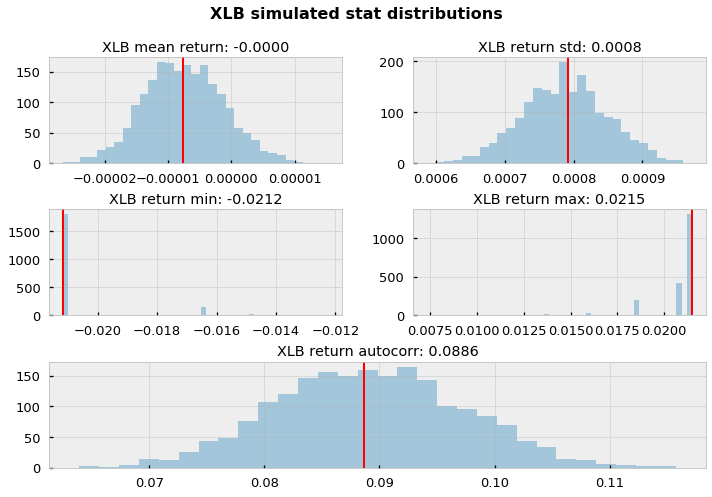

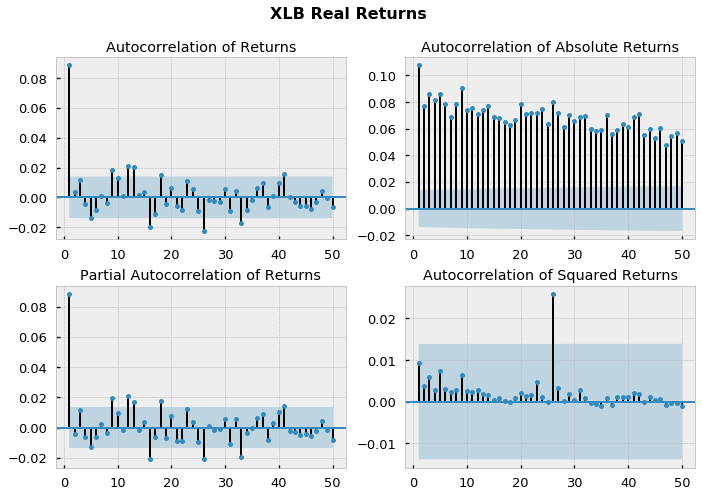

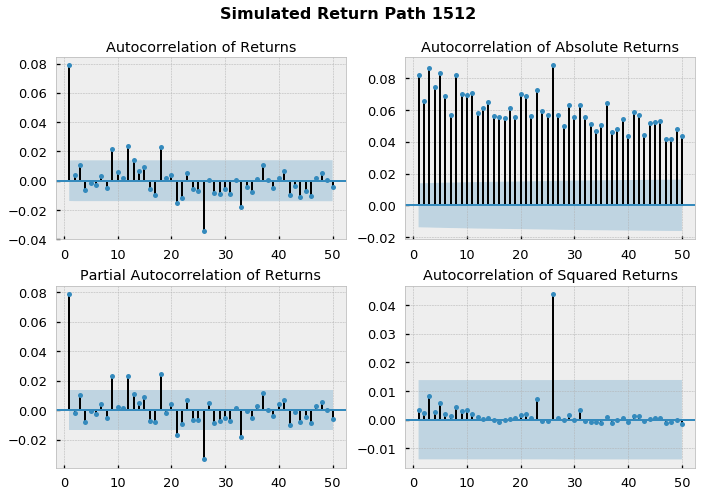

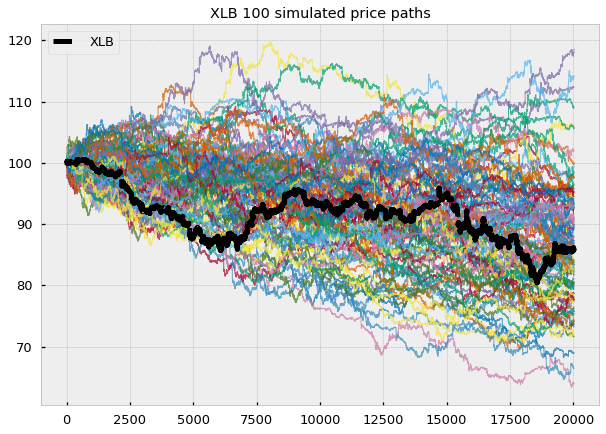

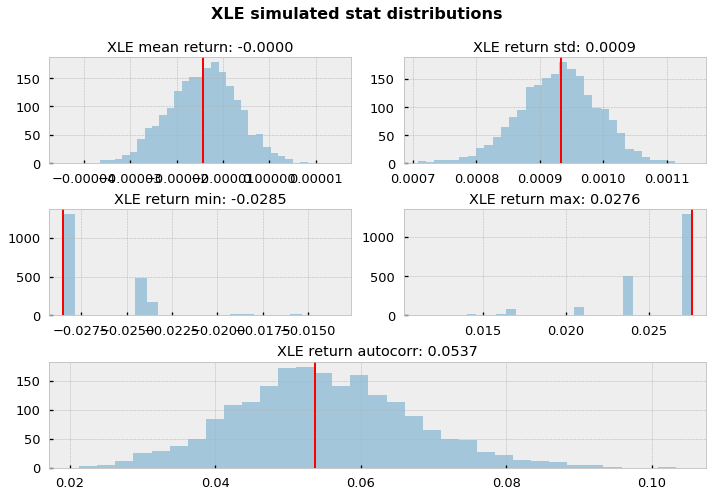

...

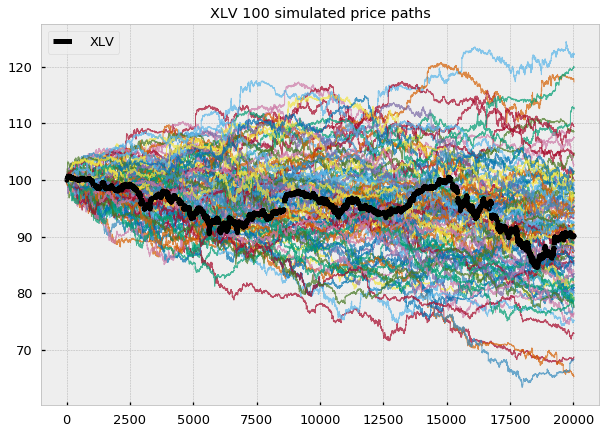

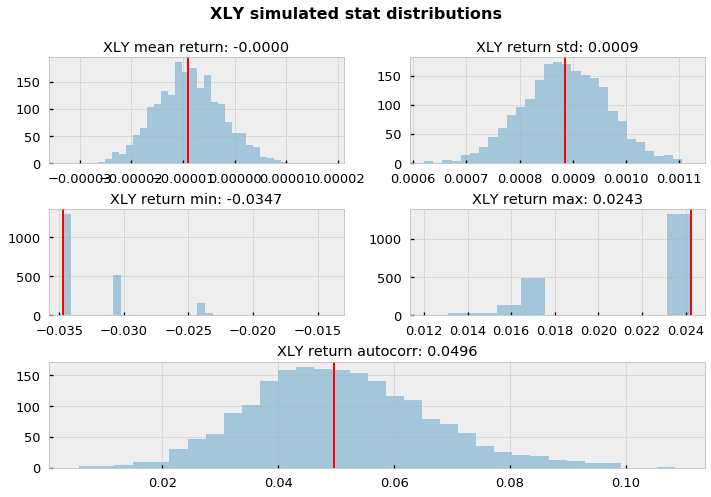

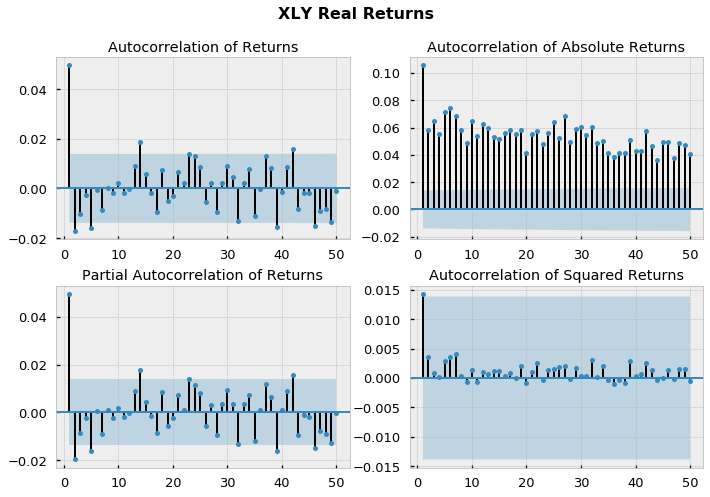

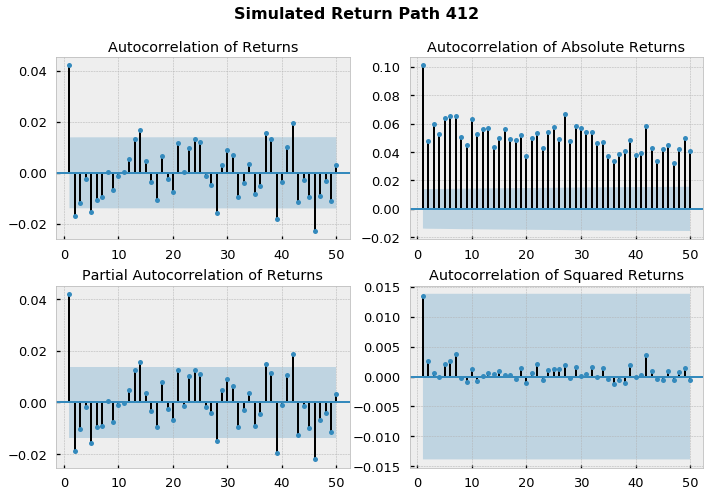

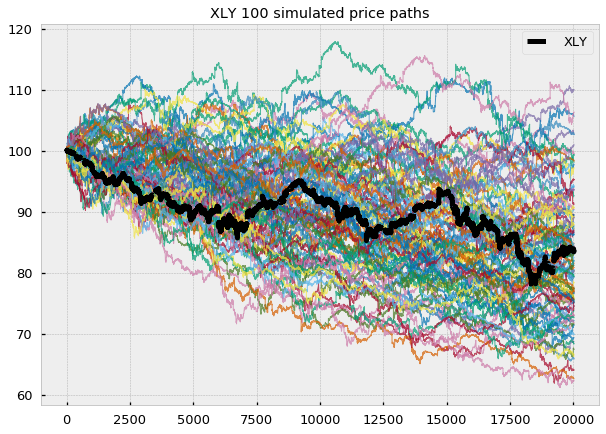

In [20]:
sim_dict = dict()

for sec in sector_returns:
    tmp = sector_returns[sec]
    N_paths = 2000
    sec_sims = CBB(tmp, blocksize=bsize, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
          XLB     XLE     XLF     XLI     XLK     XLP     XLU     XLV     XLY
20023 -0.0002  0.0001  0.0003  0.0008 -0.0001 -0.0003  0.0000 -0.0000  0.0000
20024 -0.0003  0.0000  0.0001 -0.0004  0.0005 -0.0001 -0.0002  0.0000 -0.0029
20025 -0.0001  0.0004 -0.0002  0.0008 -0.0001 -0.0013 -0.0000 -0.0003  0.0002
20026  0.0005 -0.0001  0.0002 -0.0001  0.0004  0.0003 -0.0003 -0.0000  0.0005
20027 -0.0005 -0.0007  0.0007  0.0003 -0.0004  0.0000 -0.0002  0.0003  0.0001
--------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20028 entries, 0 to 20027
Data columns (total 9 columns):
XLB    20028 non-null float64
XLE    20028 non-null float64
XLF    20028 non-null float64
XLI    20028 non-null float64
XLK    20028 non-null float64
XLP    20028 non-null float64
XLU    2002

,XLB,XLE,XLF,XLI,XLK,XLP,XLU,XLV,XLY
XLB,1.0000,-0.0073,-0.0073,0.0073,-0.0004,0.0059,-0.0045,0.0015,0.0026
XLE,-0.0073,1.0000,-0.0033,-0.0133,-0.0124,0.0000,-0.0020,-0.0138,0.0045
XLF,-0.0073,-0.0033,1.0000,-0.0035,-0.0005,0.0094,-0.0052,0.0036,0.0113
XLI,0.0073,-0.0133,-0.0035,1.0000,-0.0205,0.0121,-0.0007,0.0016,0.0013
XLK,-0.0004,-0.0124,-0.0005,-0.0205,1.0000,0.0010,-0.0098,-0.0062,0.0067
XLP,0.0059,0.0000,0.0094,0.0121,0.0010,1.0000,-0.0055,-0.0007,0.0152
XLU,-0.0045,-0.0020,-0.0052,-0.0007,-0.0098,-0.0055,1.0000,0.0019,-0.0058
XLV,0.0015,-0.0138,0.0036,0.0016,-0.0062,-0.0007,0.0019,1.0000,0.0139
XLY,0.0026,0.0045,0.0113,0.0013,0.0067,0.0152,-0.0058,0.0139,1.0000


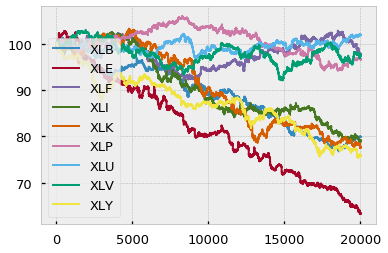

In [21]:
n_cols = 2
merged = dict()

for sym in sim_dict.keys():
    np.random.seed(0)
    tmp = sim_dict[sym]
    # pick random set of columns
    col_idx = np.random.randint(0, len(tmp.columns)+1, n_cols)
    merged[sym] = tmp[col_idx].mean(axis=1)

df = pd.DataFrame(merged)
cprint(df)

display(df.corr())

to_price_index(df).plot()

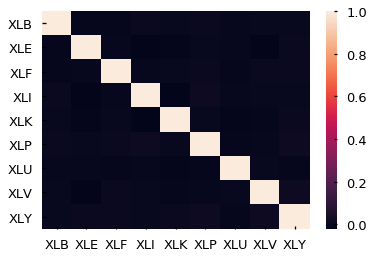

In [22]:
sns.heatmap(df.corr())

## Regenerate Synthetics with Smaller Blocks

In [23]:
bsize = len(sector_returns)//1000
bsize

20

2000it [00:00, 2001.74it/s]


,XLB,677,980,1240,156,522,529,666,1739,937,...,1268,579,1387,1554,1295,161,609,453,1135,944
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,...,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0007,0.0009,0.0008,0.0008,...,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008
min,-0.0212,-0.0212,-0.0212,-0.0210,-0.0212,-0.0212,-0.0165,-0.0212,-0.0148,-0.0212,...,-0.0212,-0.0212,-0.0210,-0.0212,-0.0212,-0.0212,-0.0212,-0.0212,-0.0212,-0.0210
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0001,0.0002,0.0002,0.0002,0.0001,0.0002,0.0002,0.0002,0.0001,...,0.0002,0.0001,0.0002,0.0002,0.0002,0.0002,0.0002,0.0001,0.0001,0.0002
max,0.0215,0.0215,0.0122,0.0215,0.0215,0.0215,0.0159,0.0215,0.0215,0.0215,...,0.0215,0.0159,0.0215,0.0159,0.0215,0.0209,0.0185,0.0215,0.0215,0.0215
skew,0.1371,-0.1417,-6.1776,1.2851,1.0850,0.7289,-0.5612,2.0744,3.1372,2.4930,...,2.1272,-2.2079,1.2361,-4.9260,-2.3792,-1.3809,-0.4451,-3.0906,-0.1248,1.3562
kurtosis,181.2890,190.5087,174.3888,176.9133,211.3141,218.5825,100.6125,184.8790,154.4930,178.0023,...,203.2630,155.4187,180.7399,168.0472,192.0637,153.6302,160.8378,209.1074,205.2468,211.1271


2000it [00:01, 1527.09it/s]


,XLE,1178,867,1421,1540,407,924,776,907,889,...,1441,1370,467,1500,1750,719,1127,1433,1870,29
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0009,0.0009,0.0009,0.0009,0.0010,0.0010,0.0009,0.0009,0.0009,0.0009,...,0.0009,0.0009,0.0010,0.0009,0.0009,0.0009,0.0009,0.0010,0.0009,0.0009
min,-0.0285,-0.0285,-0.0243,-0.0285,-0.0285,-0.0285,-0.0285,-0.0190,-0.0243,-0.0190,...,-0.0243,-0.0285,-0.0285,-0.0243,-0.0237,-0.0237,-0.0243,-0.0285,-0.0190,-0.0243
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0276,0.0238,0.0276,0.0238,0.0276,0.0238,0.0276,0.0276,0.0238,0.0276,...,0.0238,0.0276,0.0238,0.0276,0.0238,0.0276,0.0276,0.0276,0.0276,0.0276
skew,-1.1478,-2.8260,1.0916,-2.4168,0.8885,-4.2321,-2.4182,5.9813,-3.7479,1.6226,...,0.0636,-3.2737,-5.0477,-1.8505,-3.5507,2.7036,1.2201,-0.4163,-0.3846,0.8656
kurtosis,214.0395,223.2623,196.0302,187.9230,220.6214,200.8067,232.7723,232.7578,185.5386,164.9665,...,174.3500,216.3197,233.4102,189.9042,164.5938,186.7034,193.9302,203.4123,192.9288,177.8141


2000it [00:01, 1861.51it/s]


,XLF,1740,3,556,14,1744,1109,1036,1738,1830,...,1273,1254,1758,1349,551,880,966,247,826,1937
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0008,0.0009,0.0008,0.0008,0.0008,0.0007,0.0008,0.0008,...,0.0008,0.0009,0.0008,0.0007,0.0009,0.0008,0.0008,0.0007,0.0008,0.0008
min,-0.0240,-0.0199,-0.0240,-0.0240,-0.0240,-0.0240,-0.0240,-0.0240,-0.0240,-0.0240,...,-0.0240,-0.0240,-0.0240,-0.0199,-0.0240,-0.0199,-0.0188,-0.0161,-0.0240,-0.0240
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0196,0.0196,0.0196,0.0196,0.0196,0.0196,0.0124,0.0116,0.0196,0.0124,...,0.0157,0.0196,0.0196,0.0124,0.0164,0.0196,0.0196,0.0164,0.0196,0.0196
skew,-1.8309,-1.8669,-2.0439,-3.7788,-3.4560,-1.4950,-4.1251,-5.2518,0.8244,-7.6571,...,-2.7196,-1.9024,0.2801,-1.8443,-1.2959,2.5587,0.9814,0.5453,-1.5732,-2.5499
kurtosis,163.3457,149.3680,172.9099,175.8822,156.8778,164.4893,152.2320,152.8054,158.3904,222.6836,...,140.8416,193.5190,190.7759,89.9409,119.6764,148.7031,150.6661,103.5064,157.0718,183.7905


2000it [00:00, 2006.46it/s]


,XLI,591,756,1122,925,1600,880,166,946,1895,...,913,1003,1283,855,521,432,816,301,1198,1673
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0008,0.0009,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,...,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008
min,-0.0243,-0.0243,-0.0243,-0.0196,-0.0196,-0.0243,-0.0243,-0.0243,-0.0243,-0.0243,...,-0.0243,-0.0243,-0.0243,-0.0243,-0.0196,-0.0196,-0.0243,-0.0243,-0.0243,-0.0196
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0223,0.0223,0.0091,0.0223,0.0155,0.0223,0.0125,0.0223,0.0223,0.0155,...,0.0223,0.0223,0.0125,0.0155,0.0223,0.0223,0.0223,0.0155,0.0223,0.0155
skew,-2.0874,-3.8477,-6.3408,-2.0301,-2.3205,-2.1235,-5.8893,-1.1540,-2.2837,-3.7214,...,-0.9359,-1.4121,-3.0722,-2.6817,0.4404,2.0420,-1.8390,-1.9374,-1.1277,-0.8874
kurtosis,159.4556,204.0114,153.0070,153.4632,107.1216,150.7252,163.1473,158.6432,133.1090,126.0889,...,192.0133,191.2180,133.1437,156.3091,161.1342,161.4159,169.0677,132.9042,156.8377,117.1895


2000it [00:00, 2120.20it/s]


,XLK,515,1724,589,1434,484,423,1566,1271,477,...,254,1294,1145,69,919,787,737,62,691,1667
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000
std,0.0010,0.0008,0.0010,0.0010,0.0010,0.0010,0.0010,0.0009,0.0009,0.0010,...,0.0009,0.0010,0.0009,0.0010,0.0009,0.0009,0.0010,0.0009,0.0011,0.0010
min,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0217,-0.0217,-0.0217,...,-0.0217,-0.0250,-0.0250,-0.0250,-0.0250,-0.0250,-0.0217,-0.0217,-0.0250,-0.0217
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0262,0.0262,0.0262,0.0262,0.0234,0.0234,0.0262,0.0168,0.0262,0.0262,...,0.0234,0.0262,0.0262,0.0262,0.0234,0.0234,0.0262,0.0262,0.0262,0.0234
skew,-1.4734,-0.5641,-4.1772,0.2764,-6.4935,-5.2622,-0.3953,-2.1598,-0.8621,-2.0962,...,-2.0640,-3.1550,-2.3444,-2.6528,-3.8514,-1.1022,-2.1969,2.3482,-1.4198,-2.5362
kurtosis,169.0033,144.6124,186.9137,210.4360,180.4816,179.8373,179.3953,123.0319,154.4180,156.2109,...,143.0848,201.6141,199.1844,180.1259,153.0189,165.2174,153.4307,151.1748,165.1128,131.1736


2000it [00:01, 1820.21it/s]


,XLP,1647,1515,1565,1282,1308,1406,586,1390,163,...,1,830,1075,1923,542,870,120,1083,1762,837
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0006,0.0006,0.0006,0.0005,0.0006,0.0006,0.0006,0.0006,0.0006,0.0005,...,0.0006,0.0005,0.0006,0.0006,0.0005,0.0006,0.0006,0.0006,0.0006,0.0006
min,-0.0205,-0.0205,-0.0205,-0.0205,-0.0205,-0.0205,-0.0123,-0.0205,-0.0123,-0.0123,...,-0.0205,-0.0123,-0.0205,-0.0205,-0.0123,-0.0205,-0.0205,-0.0205,-0.0205,-0.0205
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0164,0.0164,0.0164,0.0100,0.0085,0.0164,0.0164,0.0100,0.0164,0.0100,...,0.0164,0.0085,0.0164,0.0164,0.0164,0.0164,0.0164,0.0100,0.0164,0.0164
skew,-2.6199,-2.5297,-1.8718,-4.4267,-6.6827,-3.7349,-0.2222,-7.2700,-0.1933,-1.4516,...,-3.2955,-1.6504,-3.4354,-2.1199,0.1334,-4.8149,-3.8084,-3.8218,-2.8477,-3.1024
kurtosis,179.0759,171.3726,177.0812,154.2791,236.2330,181.8034,140.8859,270.7496,114.8396,81.6045,...,186.8181,63.2578,283.3236,177.4215,100.6963,259.1166,239.4574,144.8828,214.1250,261.4663


2000it [00:00, 2149.37it/s]


,XLU,766,1688,946,964,1758,6,1215,630,1344,...,1288,471,1894,1113,293,8,1420,1957,804,1167
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,0.0000,0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,...,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000
std,0.0006,0.0006,0.0007,0.0006,0.0006,0.0006,0.0006,0.0006,0.0006,0.0007,...,0.0007,0.0007,0.0007,0.0006,0.0007,0.0007,0.0006,0.0007,0.0006,0.0006
min,-0.0288,-0.0131,-0.0288,-0.0288,-0.0131,-0.0117,-0.0131,-0.0288,-0.0122,-0.0288,...,-0.0288,-0.0288,-0.0288,-0.0131,-0.0288,-0.0288,-0.0288,-0.0288,-0.0288,-0.0288
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0165,0.0165,0.0127,0.0165,0.0165,0.0165,0.0094,0.0127,0.0165,0.0165,...,0.0127,0.0165,0.0165,0.0127,0.0127,0.0165,0.0165,0.0127,0.0094,0.0165
skew,-4.6218,-0.4098,-8.4375,-4.6058,0.2684,1.4073,-1.1883,-4.6658,2.8860,-2.2420,...,-8.4369,-2.0535,-7.3364,-1.6599,-10.9997,-4.3866,-5.6146,-4.7903,-5.5295,-2.3420
kurtosis,288.4771,107.1373,416.1029,287.8695,89.5112,103.2450,74.0028,305.3777,148.0466,300.0195,...,408.8205,282.3211,406.3395,74.0284,493.9227,273.0486,306.8650,251.6421,291.6380,279.3676


2000it [00:01, 1835.16it/s]


,XLV,1837,228,8,1278,1248,121,784,633,444,...,43,1414,1492,284,478,221,159,1409,1528,947
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000
std,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,...,0.0006,0.0006,0.0007,0.0007,0.0007,0.0007,0.0006,0.0006,0.0006,0.0007
min,-0.0210,-0.0117,-0.0210,-0.0210,-0.0152,-0.0210,-0.0152,-0.0205,-0.0210,-0.0210,...,-0.0205,-0.0205,-0.0210,-0.0210,-0.0210,-0.0210,-0.0205,-0.0210,-0.0152,-0.0210
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0001,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,0.0157,...,0.0094,0.0137,0.0157,0.0157,0.0157,0.0157,0.0157,0.0156,0.0156,0.0157
skew,-2.3524,1.9497,-3.8050,-2.2142,0.0358,-3.1237,-0.3229,-0.7431,-4.6582,-1.2292,...,-4.1518,-2.8448,-2.0246,-2.1495,-2.6590,0.0104,0.0884,-0.6330,-1.3146,-4.8903
kurtosis,169.5654,107.8261,197.8220,173.1988,84.1140,192.0715,108.1389,187.3340,194.7046,159.5923,...,159.6766,112.7442,213.9536,192.6115,178.3424,141.2140,142.6760,142.3703,101.8394,228.8681


2000it [00:00, 2125.87it/s]


,XLY,1020,1576,1133,808,979,586,1062,1029,374,...,1457,35,1333,1567,436,1636,1913,1274,381,1522
count,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000",...,"20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000","20,028.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000
std,0.0009,0.0009,0.0009,0.0009,0.0010,0.0010,0.0009,0.0008,0.0009,0.0009,...,0.0009,0.0009,0.0009,0.0009,0.0008,0.0008,0.0008,0.0009,0.0008,0.0009
min,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0347,-0.0239,-0.0306,-0.0306,...,-0.0347,-0.0347,-0.0347,-0.0306,-0.0306,-0.0142,-0.0142,-0.0347,-0.0306,-0.0306
25%,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,-0.0002,...,-0.0002,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,-0.0001,-0.0002,-0.0001,-0.0002
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0002,0.0001,0.0001,0.0001,0.0002,0.0001,0.0001,0.0002,0.0001
max,0.0243,0.0243,0.0243,0.0170,0.0243,0.0170,0.0146,0.0155,0.0243,0.0243,...,0.0243,0.0155,0.0243,0.0243,0.0155,0.0243,0.0243,0.0243,0.0243,0.0243
skew,-5.8846,-3.7884,-7.3464,-7.5966,-10.2302,-10.7390,-11.4218,-4.2366,-2.8387,-3.1804,...,-2.0146,-8.0856,-5.0532,-5.7722,-6.5593,1.9519,2.3921,-7.3853,-1.2999,-6.2241
kurtosis,322.3403,338.0267,355.3725,335.4467,397.7533,435.0558,456.5697,178.3485,298.6801,348.5538,...,265.1206,342.8499,316.7715,290.1377,257.4333,150.0971,164.0710,398.6008,261.3226,320.5218


<Figure size 432x288 with 0 Axes>

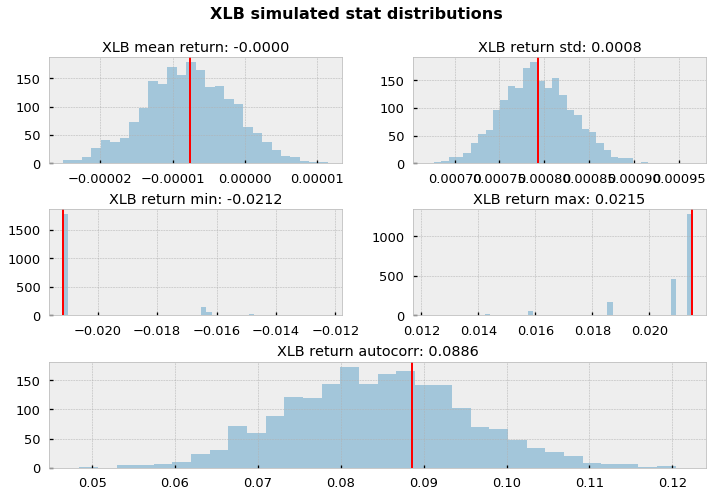

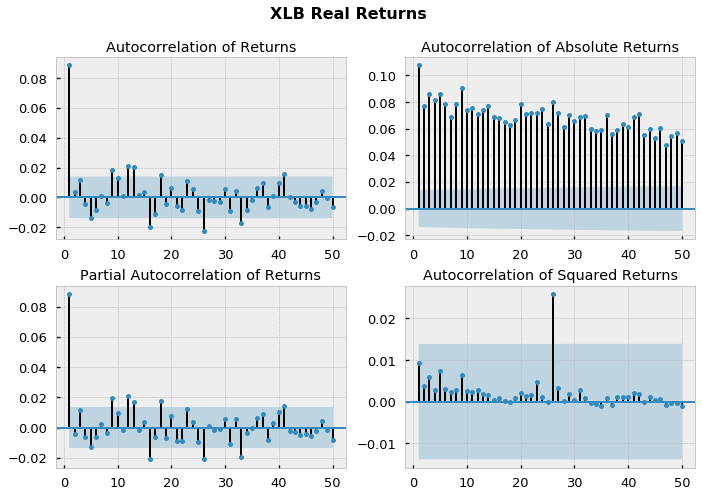

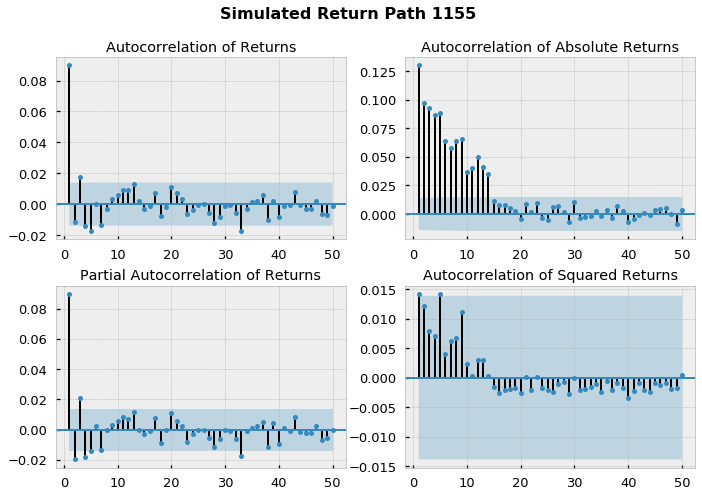

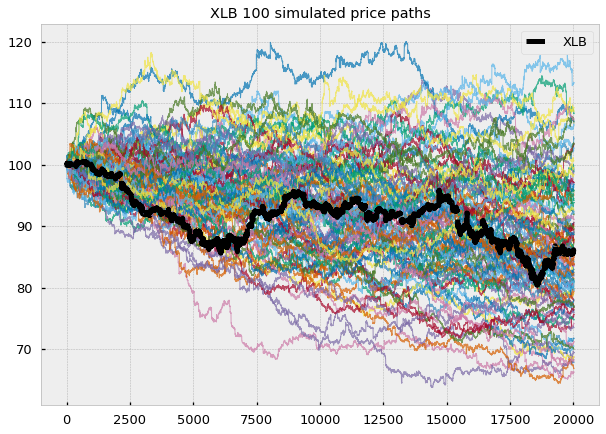

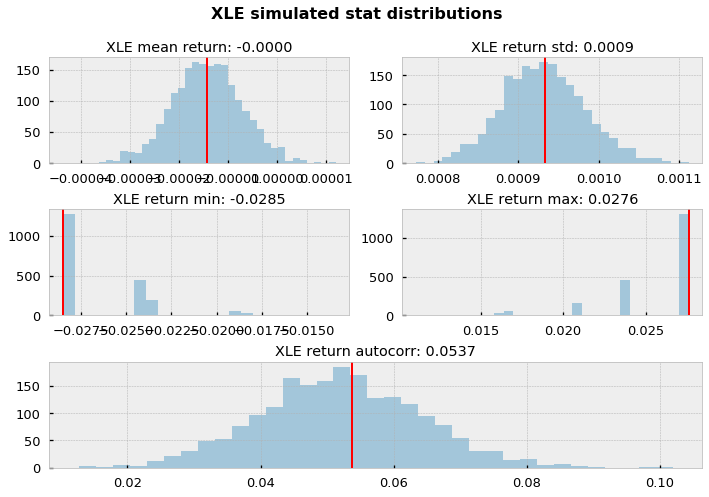

...

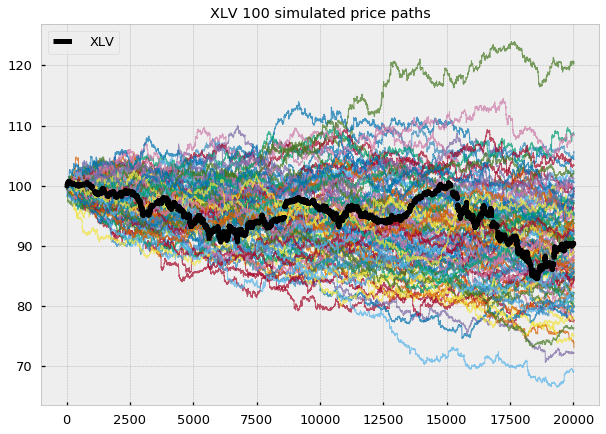

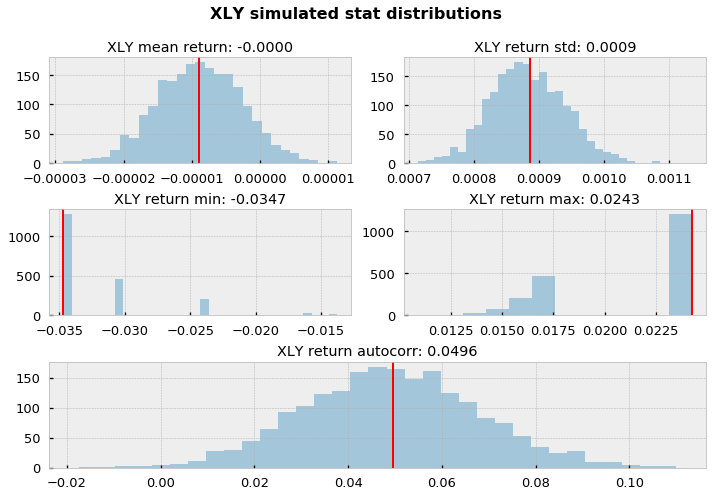

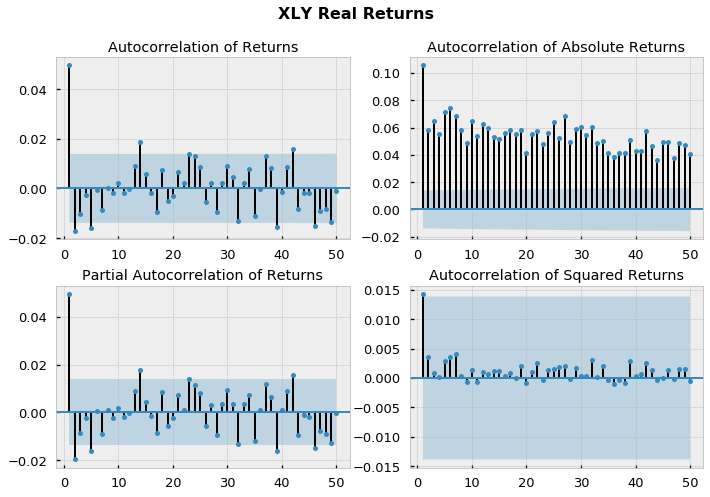

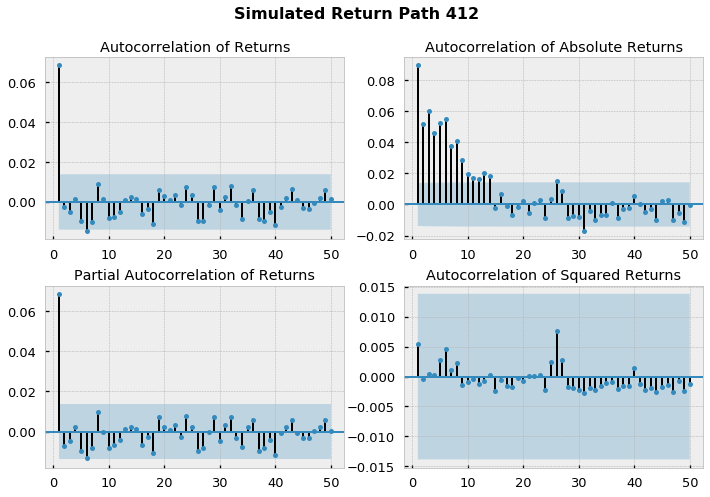

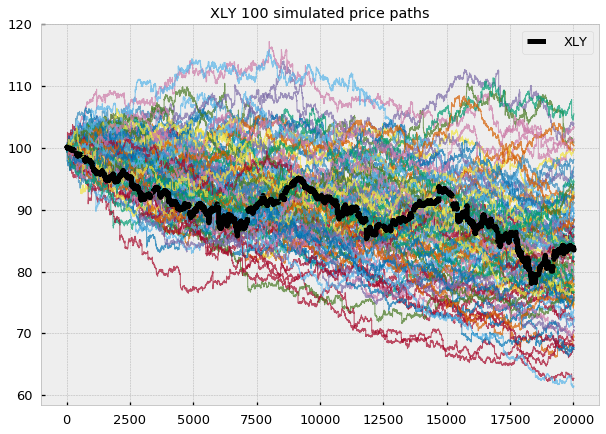

In [24]:
sim_dict = dict()

for sec in sector_returns:
    tmp = sector_returns[sec]
    N_paths = 2000
    sec_sims = CBB(tmp, blocksize=bsize, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

## Additional ETF synthetics

In [25]:
symbols = ['SPY', 'IWM', 'ACWI', 'EEM', 'GLD',
           'TLT', 'BND', 'SHY', 'LQD', 'HYG', 'VNQ']

etfs = to_returns(prices[symbols].dropna())
cprint(etfs)

-------------------------------------------------------------------------------
dataframe information
-------------------------------------------------------------------------------
symbol                  SPY     IWM    ACWI     EEM     GLD     TLT    BND  \
dates                                                                        
2018-12-31 13:55:00  0.0006  0.0013  0.0006  0.0005 -0.0001  0.0001 0.0000   
2018-12-31 13:56:00  0.0006  0.0014  0.0003  0.0005 -0.0001  0.0000 0.0000   
2018-12-31 13:57:00 -0.0022 -0.0011 -0.0013 -0.0010 -0.0000  0.0002 0.0000   
2018-12-31 13:58:00  0.0004  0.0001 -0.0001  0.0008 -0.0001 -0.0001 0.0000   
2018-12-31 13:59:00  0.0011 -0.0002  0.0006  0.0003  0.0001  0.0001 0.0002   

symbol                  SHY     LQD     HYG     VNQ  
dates                                                
2018-12-31 13:55:00 -0.0001  0.0000  0.0002  0.0008  
2018-12-31 13:56:00 -0.0000  0.0001  0.0003  0.0019  
2018-12-31 13:57:00 -0.0001  0.0000 -0.0005 -0.0013  
2

2000it [00:01, 1441.34it/s]


,SPY,113,1601,1217,315,1841,188,1749,1519,1400,...,458,857,1764,1796,177,42,792,1228,632,1523
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,...,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007,0.0007
min,-0.0174,-0.0172,-0.0172,-0.0172,-0.0137,-0.0172,-0.0174,-0.0172,-0.0174,-0.0172,...,-0.0167,-0.0167,-0.0167,-0.0174,-0.0174,-0.0172,-0.0174,-0.0174,-0.0172,-0.0167
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0003,0.0003,0.0002,0.0002,0.0003,0.0003,...,0.0002,0.0002,0.0002,0.0003,0.0002,0.0003,0.0002,0.0002,0.0003,0.0002
max,0.0151,0.0151,0.0151,0.0140,0.0138,0.0140,0.0151,0.0140,0.0151,0.0151,...,0.0151,0.0151,0.0151,0.0151,0.0151,0.0151,0.0140,0.0151,0.0151,0.0151
skew,-1.9427,-1.5934,0.5309,-0.7475,0.1073,-3.6428,-0.8783,-1.7674,-1.9066,-1.9644,...,-0.0328,-1.5710,-2.0569,-3.9726,0.6549,0.6636,-5.5873,-1.3771,-1.1314,-0.1267
kurtosis,135.7526,150.6978,127.5928,137.7303,84.6741,139.8318,142.7964,98.8066,129.6674,132.0144,...,108.7389,124.8278,121.6657,154.8474,156.0084,133.1368,162.6387,139.5350,151.5716,123.5925


2000it [00:00, 2177.62it/s]


,IWM,212,81,1286,1074,265,1906,5,1797,1981,...,566,1358,753,125,1414,1622,264,634,399,1795
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0007,0.0008,0.0007,0.0007,0.0008,0.0007,0.0008,0.0008,...,0.0008,0.0008,0.0008,0.0007,0.0008,0.0008,0.0008,0.0008,0.0008,0.0008
min,-0.0202,-0.0168,-0.0202,-0.0168,-0.0177,-0.0202,-0.0202,-0.0202,-0.0177,-0.0202,...,-0.0202,-0.0177,-0.0202,-0.0124,-0.0202,-0.0177,-0.0202,-0.0168,-0.0202,-0.0202
25%,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,...,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
max,0.0145,0.0145,0.0145,0.0145,0.0145,0.0145,0.0135,0.0145,0.0110,0.0145,...,0.0145,0.0145,0.0135,0.0135,0.0135,0.0145,0.0135,0.0145,0.0145,0.0135
skew,-2.5253,-2.0364,-2.6869,-1.3275,-2.0373,-2.0454,-2.1633,-1.7819,-3.6592,-3.5099,...,-2.2120,-1.1807,-3.6691,-0.1221,-3.5562,-1.3457,-3.9541,-1.9652,-2.5521,-3.1215
kurtosis,104.6582,77.7391,118.4079,77.7146,103.5452,99.9602,109.2990,99.5228,106.0419,110.4966,...,107.6019,90.6505,129.4762,37.2707,118.3479,82.6710,129.8126,81.3485,126.7357,96.8011


2000it [00:00, 2149.48it/s]


,ACWI,769,1767,962,637,1150,958,1981,395,1050,...,828,1086,682,1710,1731,371,418,726,197,513
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
std,0.0006,0.0006,0.0006,0.0006,0.0006,0.0006,0.0007,0.0006,0.0006,0.0007,...,0.0006,0.0006,0.0007,0.0006,0.0006,0.0006,0.0007,0.0006,0.0006,0.0006
min,-0.0167,-0.0151,-0.0153,-0.0167,-0.0167,-0.0167,-0.0167,-0.0167,-0.0144,-0.0167,...,-0.0167,-0.0167,-0.0167,-0.0167,-0.0167,-0.0151,-0.0153,-0.0151,-0.0167,-0.0167
25%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
max,0.0151,0.0151,0.0151,0.0151,0.0134,0.0151,0.0151,0.0151,0.0134,0.0134,...,0.0134,0.0151,0.0151,0.0134,0.0134,0.0151,0.0151,0.0134,0.0124,0.0151
skew,-1.9723,-1.2960,-2.9620,-3.2450,-2.3807,1.7215,-3.7871,-1.5880,0.5969,-3.3979,...,-3.0702,-3.0542,-1.1676,1.0592,-6.3292,-3.2281,-3.9710,-0.5625,-1.0234,-3.8973
kurtosis,184.3940,181.7890,190.4615,199.0968,163.1057,181.6962,182.0486,188.5716,150.4877,199.9873,...,194.6107,226.4913,181.6373,140.5830,221.0016,157.0432,170.4355,155.7410,147.5997,219.9716


2000it [00:00, 2151.77it/s]


,EEM,494,1871,219,820,560,107,487,1308,1802,...,330,1225,272,1028,154,749,724,90,1638,1877
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000
std,0.0008,0.0008,0.0007,0.0008,0.0007,0.0007,0.0008,0.0008,0.0008,0.0008,...,0.0008,0.0008,0.0008,0.0008,0.0009,0.0009,0.0007,0.0008,0.0008,0.0008
min,-0.0226,-0.0226,-0.0226,-0.0226,-0.0204,-0.0204,-0.0226,-0.0226,-0.0226,-0.0226,...,-0.0226,-0.0226,-0.0226,-0.0226,-0.0226,-0.0226,-0.0226,-0.0226,-0.0226,-0.0226
25%,-0.0002,-0.0003,-0.0002,-0.0002,-0.0002,-0.0003,-0.0002,-0.0002,-0.0003,-0.0002,...,-0.0002,-0.0002,-0.0003,-0.0002,-0.0003,-0.0003,-0.0002,-0.0002,-0.0002,-0.0003
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
max,0.0242,0.0242,0.0242,0.0242,0.0242,0.0242,0.0242,0.0181,0.0242,0.0173,...,0.0242,0.0242,0.0242,0.0181,0.0181,0.0242,0.0242,0.0181,0.0242,0.0242
skew,-0.1780,-0.4885,-0.3095,-4.0768,0.1299,4.2493,-2.7809,-5.1059,0.7594,-5.7570,...,-0.6813,-6.4116,1.6848,-1.6379,-3.1225,0.9598,4.3015,-0.0033,-1.4276,-0.5942
kurtosis,258.8837,308.7587,313.5124,294.4639,281.1151,330.2965,272.8270,273.3847,259.6875,245.0028,...,261.8980,279.8267,290.8805,235.4039,237.1729,263.5386,274.6021,203.7074,247.6395,282.4913


2000it [00:00, 2167.82it/s]


,GLD,910,1695,334,505,1136,1101,911,1773,1613,...,951,1166,1713,639,1951,1360,613,929,1308,233
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000,0.0000,...,0.0000,0.0000,0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000
std,0.0004,0.0004,0.0004,0.0004,0.0004,0.0004,0.0004,0.0004,0.0004,0.0003,...,0.0004,0.0004,0.0004,0.0003,0.0004,0.0004,0.0004,0.0003,0.0003,0.0003
min,-0.0138,-0.0138,-0.0109,-0.0138,-0.0138,-0.0138,-0.0138,-0.0109,-0.0138,-0.0138,...,-0.0047,-0.0138,-0.0138,-0.0138,-0.0138,-0.0109,-0.0138,-0.0109,-0.0138,-0.0138
25%,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0001,0.0000,0.0001,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0001,0.0001,0.0001,0.0000,0.0000,0.0000,0.0000,0.0000,0.0001,0.0000
max,0.0144,0.0132,0.0144,0.0144,0.0132,0.0144,0.0144,0.0132,0.0144,0.0107,...,0.0132,0.0132,0.0144,0.0132,0.0123,0.0144,0.0144,0.0123,0.0123,0.0132
skew,10.2055,2.3744,14.2718,13.5500,3.2418,6.4586,11.0610,13.7891,-0.3286,1.9861,...,17.2521,11.2333,3.1074,-6.5802,6.6043,15.5694,9.3012,11.8843,7.1493,-0.0411
kurtosis,601.9122,551.2636,494.6185,607.0791,648.8878,696.2331,527.9346,582.4510,663.1337,508.6740,...,460.3351,590.8842,609.7670,749.5527,519.0393,575.7716,564.0511,614.5900,638.8106,797.4911


2000it [00:01, 1801.88it/s]


,TLT,70,1477,223,968,432,1300,1904,1504,793,...,981,186,644,1132,1405,1234,49,239,129,406
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,0.0000,0.0000,0.0000,0.0000,-0.0000,0.0000,0.0000,0.0000,-0.0000,0.0000,...,0.0000,-0.0000,0.0000,0.0000,-0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
std,0.0003,0.0003,0.0003,0.0004,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,...,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003,0.0003
min,-0.0069,-0.0060,-0.0069,-0.0060,-0.0069,-0.0069,-0.0060,-0.0069,-0.0060,-0.0069,...,-0.0069,-0.0069,-0.0060,-0.0069,-0.0069,-0.0058,-0.0069,-0.0060,-0.0060,-0.0069
25%,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
max,0.0096,0.0091,0.0060,0.0096,0.0091,0.0096,0.0096,0.0096,0.0096,0.0091,...,0.0091,0.0096,0.0072,0.0096,0.0091,0.0096,0.0096,0.0096,0.0096,0.0091
skew,4.4352,5.2155,0.6870,5.0951,4.2582,3.9411,5.1501,4.0913,0.9793,2.3851,...,4.3656,1.3859,4.1410,4.3245,3.5112,7.7669,5.6236,7.5006,3.8812,5.7842
kurtosis,208.6153,195.0706,148.5809,165.2571,183.4702,218.4375,202.0295,224.5576,180.8471,192.2126,...,204.9660,187.4786,146.0383,193.5538,223.5801,261.1949,250.1902,241.4015,191.3973,225.9908


2000it [00:00, 2069.90it/s]


,BND,84,26,1269,196,657,1199,637,1230,41,...,1595,1198,1315,1401,158,357,870,701,646,1563
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,-0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000
std,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
min,-0.0027,-0.0027,-0.0027,-0.0025,-0.0027,-0.0027,-0.0027,-0.0025,-0.0027,-0.0027,...,-0.0016,-0.0027,-0.0025,-0.0019,-0.0027,-0.0027,-0.0025,-0.0027,-0.0027,-0.0025
25%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
max,0.0033,0.0033,0.0033,0.0033,0.0023,0.0033,0.0021,0.0033,0.0024,0.0033,...,0.0024,0.0033,0.0033,0.0033,0.0033,0.0033,0.0033,0.0033,0.0033,0.0023
skew,2.9365,4.9578,2.2669,5.3258,-0.3531,2.5080,-2.0026,2.9254,3.0221,2.8903,...,2.6066,2.6176,4.8221,2.4962,-1.5381,1.9148,7.1752,4.4216,5.7855,2.0823
kurtosis,281.8252,308.7125,266.6380,248.1384,221.5067,296.4084,238.8937,246.8166,222.9310,345.1514,...,189.1892,275.3908,259.2988,254.8429,318.4074,389.5688,291.6320,349.3787,391.6335,188.9241


2000it [00:00, 2096.54it/s]


,SHY,1082,1587,463,936,771,1599,594,1482,135,...,651,1683,190,1278,730,1644,490,957,984,997
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000,0.0000,...,-0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000
std,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
min,-0.0021,-0.0004,-0.0021,-0.0021,-0.0016,-0.0014,-0.0014,-0.0016,-0.0016,-0.0021,...,-0.0021,-0.0016,-0.0014,-0.0021,-0.0021,-0.0021,-0.0021,-0.0016,-0.0021,-0.0021
25%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
max,0.0016,0.0016,0.0016,0.0016,0.0016,0.0016,0.0016,0.0016,0.0016,0.0016,...,0.0008,0.0009,0.0016,0.0009,0.0009,0.0016,0.0016,0.0016,0.0009,0.0008
skew,-6.6386,18.8949,-4.7572,-7.2842,1.3579,10.2173,11.1342,1.3333,0.2146,-6.4951,...,-16.6369,1.7010,8.3246,-11.8974,-16.9518,-7.7151,-7.3808,-1.9720,-6.5956,-19.5935
kurtosis,812.2771,713.9810,825.6623,852.9997,527.5481,574.6776,527.1440,682.0118,700.3729,766.9180,...,"1,106.0044",460.6044,630.6524,913.3198,958.9412,981.4554,848.0590,724.4831,645.8657,872.2842


2000it [00:00, 2127.47it/s]


,LQD,1127,1942,882,1784,1504,1533,1928,1304,265,...,824,661,1416,1634,720,1877,1065,1101,78,1532
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000
std,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
min,-0.0044,-0.0043,-0.0044,-0.0043,-0.0044,-0.0044,-0.0028,-0.0044,-0.0044,-0.0043,...,-0.0028,-0.0044,-0.0044,-0.0044,-0.0027,-0.0043,-0.0043,-0.0043,-0.0044,-0.0044
25%,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
max,0.0050,0.0031,0.0050,0.0050,0.0046,0.0050,0.0031,0.0046,0.0050,0.0050,...,0.0050,0.0050,0.0050,0.0031,0.0050,0.0050,0.0031,0.0050,0.0050,0.0046
skew,1.8693,0.3513,-1.5800,3.9412,1.4691,0.9005,1.4132,4.5957,2.7656,-0.3790,...,8.2245,0.6907,5.2183,-2.5443,3.5879,6.8464,0.9095,1.9729,0.3151,2.7680
kurtosis,394.0263,226.6345,533.0329,365.9521,310.4217,359.2107,226.0957,316.5539,446.6328,361.9779,...,405.6867,344.4966,509.0144,267.8517,310.0328,387.3741,270.9554,371.4728,406.1734,351.0420


2000it [00:00, 2153.51it/s]


,HYG,353,291,621,104,334,1910,1824,92,1298,...,1548,895,205,1385,1110,1103,97,1759,1382,561
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000
std,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,...,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002,0.0002
min,-0.0052,-0.0052,-0.0047,-0.0047,-0.0047,-0.0052,-0.0052,-0.0052,-0.0052,-0.0052,...,-0.0038,-0.0045,-0.0047,-0.0047,-0.0047,-0.0052,-0.0047,-0.0052,-0.0052,-0.0045
25%,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
max,0.0045,0.0045,0.0042,0.0045,0.0045,0.0041,0.0045,0.0045,0.0045,0.0041,...,0.0039,0.0045,0.0045,0.0042,0.0045,0.0042,0.0045,0.0045,0.0039,0.0045
skew,-2.3023,-3.9919,-3.1755,-2.8107,-2.5294,-5.1977,1.0772,-2.8722,-2.3080,-4.3494,...,-2.2386,-0.0507,0.0651,-3.0868,-0.0277,-5.1372,0.3579,-2.2148,-3.7803,3.2277
kurtosis,155.9981,161.5990,146.7170,149.6638,155.5116,167.2779,151.0723,148.9034,166.7580,173.2259,...,98.4464,135.2666,134.6617,133.9388,166.3642,156.0118,160.0824,160.5609,149.5785,145.9401


2000it [00:00, 2092.64it/s]


,VNQ,1890,894,702,773,751,1379,1312,37,620,...,363,577,170,1986,546,1839,1749,1146,1,747
count,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000",...,"19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000","19,475.0000"
mean,-0.0000,-0.0000,0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,...,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000
std,0.0007,0.0007,0.0006,0.0006,0.0006,0.0007,0.0006,0.0007,0.0007,0.0006,...,0.0007,0.0007,0.0007,0.0006,0.0006,0.0007,0.0006,0.0006,0.0006,0.0006
min,-0.0319,-0.0319,-0.0146,-0.0228,-0.0209,-0.0319,-0.0125,-0.0319,-0.0228,-0.0209,...,-0.0319,-0.0319,-0.0319,-0.0146,-0.0228,-0.0319,-0.0125,-0.0087,-0.0146,-0.0228
25%,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0002,-0.0001,...,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001,-0.0001
50%,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
75%,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,...,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001
max,0.0125,0.0125,0.0125,0.0125,0.0101,0.0125,0.0122,0.0125,0.0124,0.0124,...,0.0125,0.0124,0.0125,0.0125,0.0122,0.0124,0.0125,0.0125,0.0124,0.0101
skew,-9.1858,-10.9076,-0.8027,-3.0991,-3.6318,-10.5352,0.0046,-9.4183,-3.8658,-3.3336,...,-12.1681,-12.6691,-6.7949,0.5043,-3.8995,-12.6032,0.9252,1.5606,-0.5446,-9.9320
kurtosis,451.2637,486.0593,109.4474,267.0798,153.6820,579.9189,63.8547,494.4111,188.5878,171.9093,...,531.8643,496.5955,416.1268,86.6872,218.4092,484.4879,97.0111,73.9845,96.0734,380.9036


<Figure size 432x288 with 0 Axes>

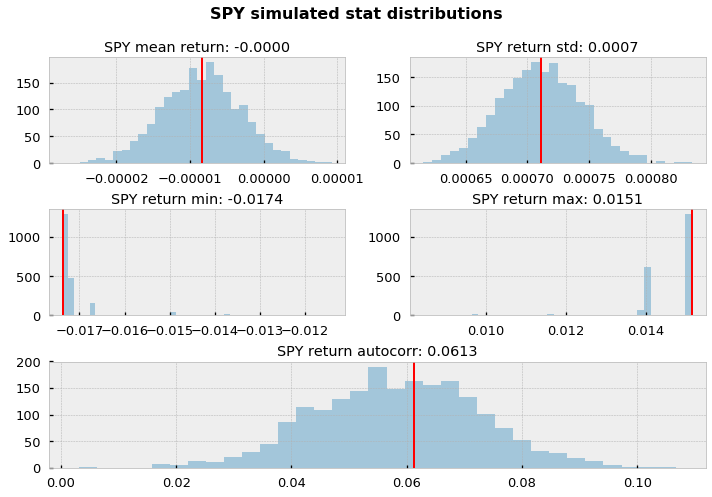

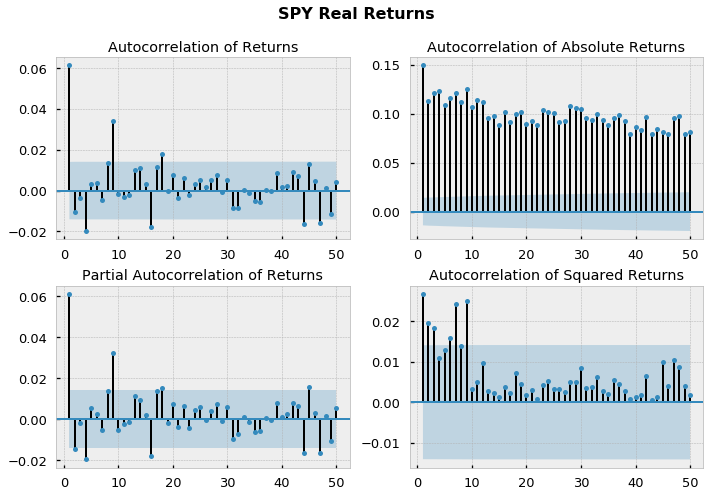

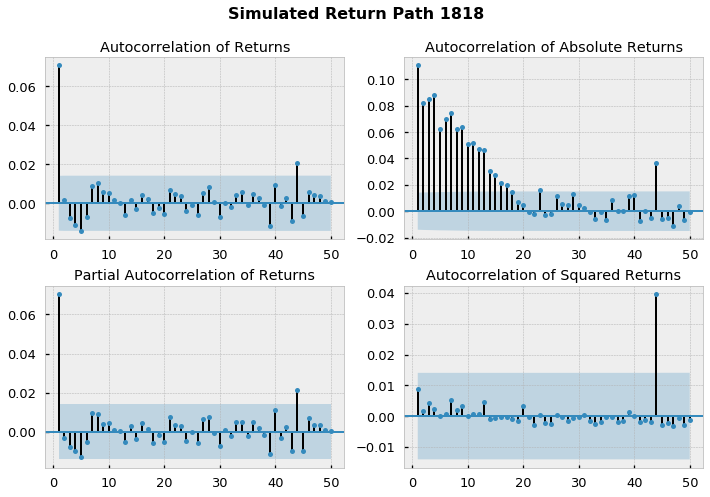

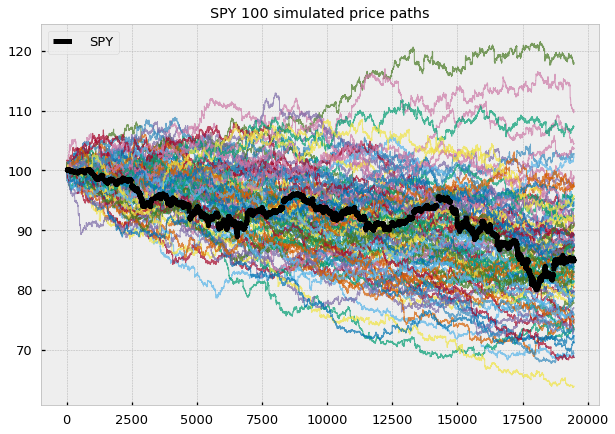

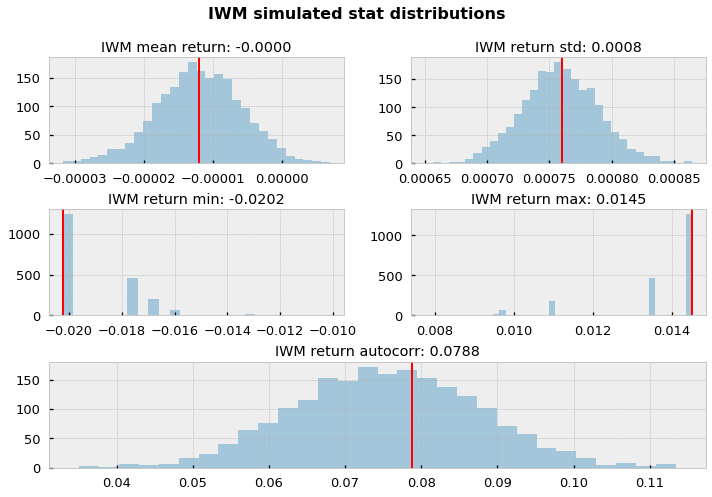

...

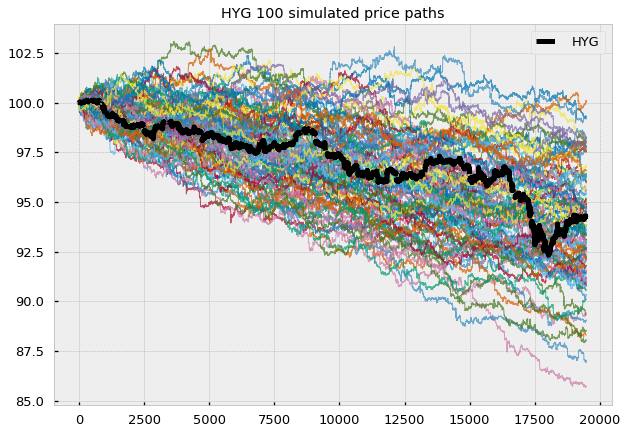

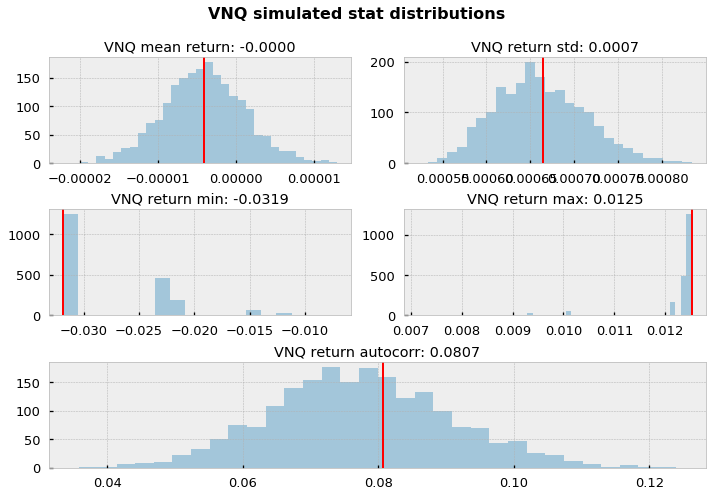

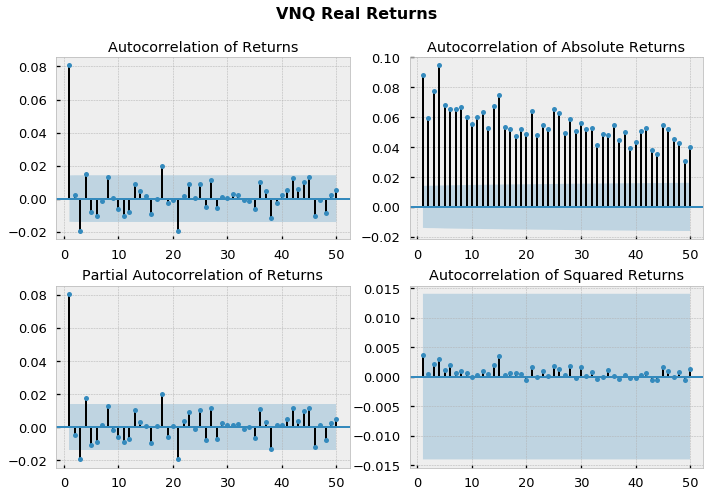

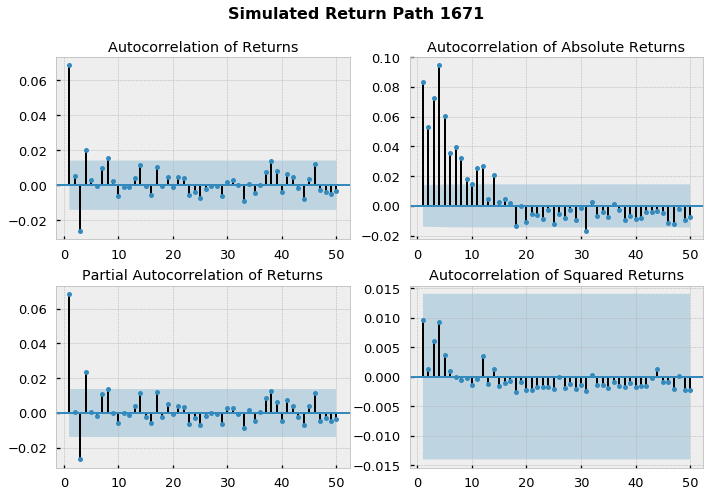

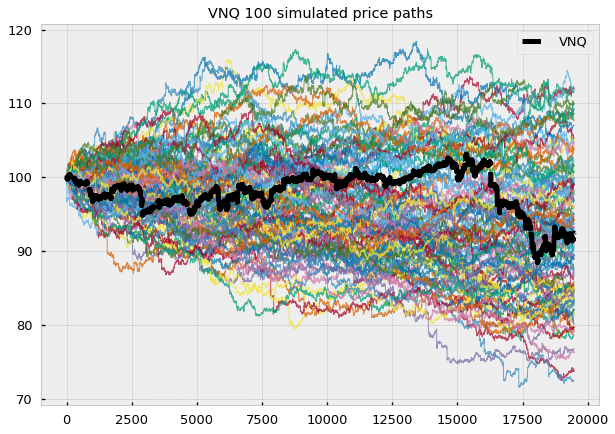

In [26]:
bsize = 20
sim_dict = dict()

for sec in etfs:
    tmp = etfs[sec]
    N_paths = 2000
    sec_sims = CBB(tmp, blocksize=bsize, N_paths=N_paths)
    sim_dict[sec] = sec_sims
    view_all(tmp, sec_sims, cmap=None)
    plot_realizations(tmp, sec_sims, start=100, 
                      n_plot_paths=100, cmap='nanex_cmap')

### Rolling Volatility

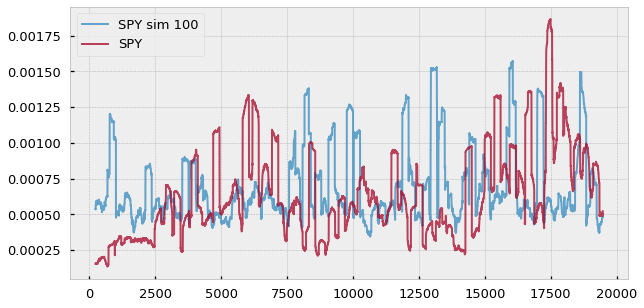

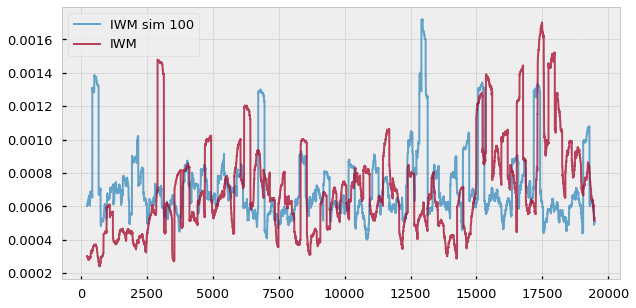

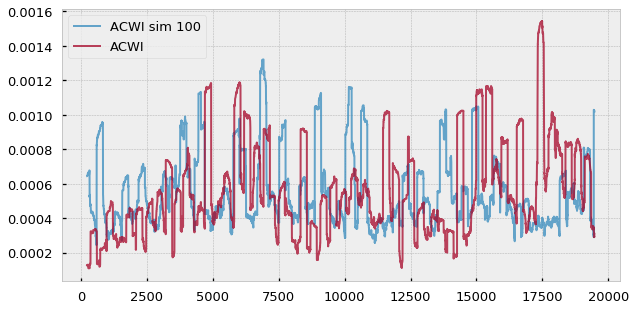

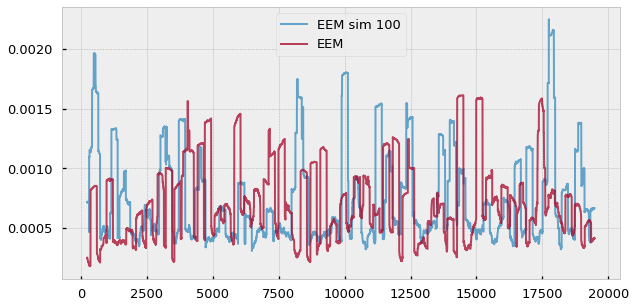

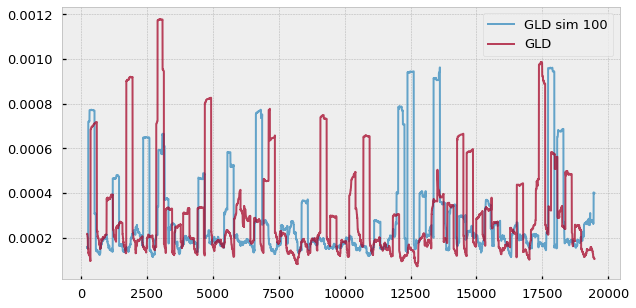

...

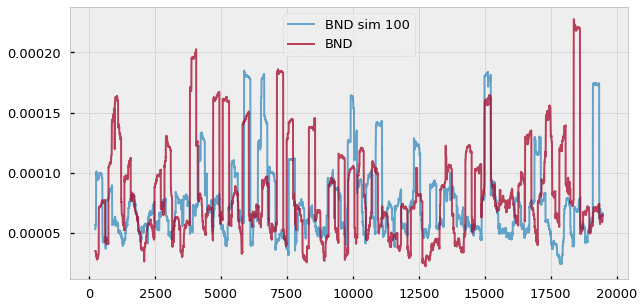

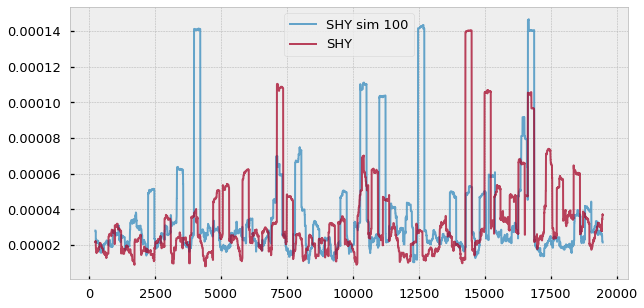

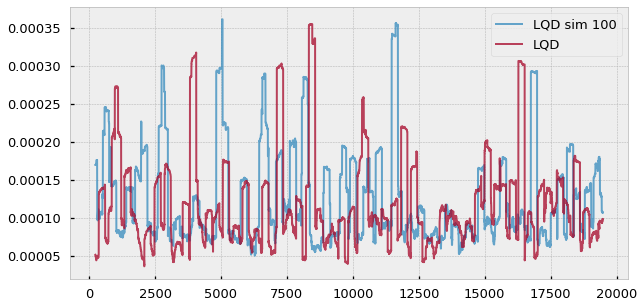

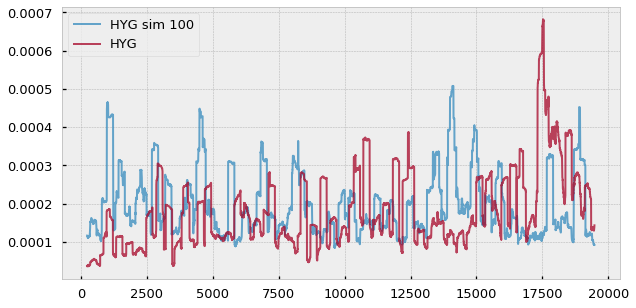

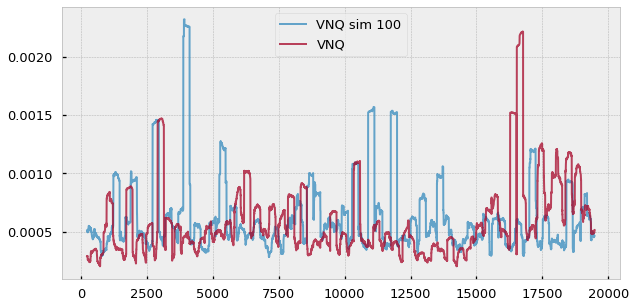

In [27]:
sim_no = 100
window = 240
for sym in etfs.columns:
    fig, ax = plt.subplots(figsize=(10,5))
    sim_dict[sym][sim_no].rolling(window).std().plot(ax=ax,
        label=f'{sym} sim {sim_no}',alpha=0.75)
    etfs[sym].reset_index(drop=True).rolling(window).std().plot(ax=ax, alpha=0.75)
    ax.legend()